In [1]:
#Load the datasets
def read_dataset(name): #when only one dataset is provided as input
    import pandas as pd
    if name == "gpsa":
        df = pd.read_csv('../datasets/googleplaystore.csv', sep=',', encoding ='ISO-8859-1')
    elif name == "gpsu":
        df = pd.read_csv('../datasets/googleplaystore_reviews.csv', sep=',',encoding = 'ISO-8859-1')  
    elif name == "titanic":
        df = pd.read_csv('../datasets/titanic/titanic_train.csv', sep=',', encoding ='ISO-8859-1')
    elif name == "house":
        df = pd.read_csv('../datasets/house/house_train.csv', sep=',', encoding ='ISO-8859-1')
    else: 
        raise ValueError('Invalid dataset name')               
    return df


In [2]:
read_dataset("titanic")

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S
...,...,...,...,...,...,...,...,...,...,...,...,...
886,887,0,2,"Montvila, Rev. Juozas",male,27.0,0,0,211536,13.0000,NaN,S
887,888,1,1,"Graham, Miss. Margaret Edith",female,19.0,0,0,112053,30.0000,B42,S
888,889,0,3,"Johnston, Miss. Catherine Helen ""Carrie""",female,NaN,1,2,W./C. 6607,23.4500,NaN,S
889,890,1,1,"Behr, Mr. Karl Howell",male,26.0,0,0,111369,30.0000,C148,C


## - Loading your data

In [3]:
import learn2clean.loading.reader as rd 
import learn2clean.normalization.normalizer as nl 
import pandas as pd

# executing profiling function for one dataset as input
rd.profile_summary(read_dataset('titanic'), plot=False)


Profiling datasets
      Attribute     Type  Num. Missing Values  Num. Unique Values           Sknewness  Kurtosis
0   PassengerId    int64                  0.0               891.0                   0      -1.2
1      Survived    int64                  0.0                 2.0            0.477717  -1.77179
2        Pclass    int64                  0.0                 3.0           -0.629486  -1.27957
3           Age  float64                177.0                89.0  0.3882898514698658  0.168637
4         SibSp    int64                  0.0                 7.0             3.68913   17.7735
5         Parch    int64                  0.0                 7.0             2.74449   9.71661
6          Fare  float64                  0.0               248.0             4.77925   33.2043
7          Name   object                  0.0               891.0                 N/A       N/A
8           Sex   object                  0.0                 2.0                 N/A       N/A
9        Ticket   obj

In [4]:

read_dataset('titanic')['Survived'].head() # the target variable is categorical (bool)


0    0
1    1
2    1
3    1
4    0
Name: Survived, dtype: int64

In [5]:

# no encoding on the target variable
d_not_enc = rd.Reader(sep=',',verbose=True, encoding=False) 

# when you have two datasets as inputs: train and test datasets
titanic  = ["../datasets/titanic/titanic_train.csv", "../datasets/titanic/test.csv"]
titanic_not_encoded = d_not_enc.train_test_split(titanic, 'Survived')
titanic_not_encoded['train'].head()


Reading csv : titanic_train.csv ...
Reading data ...
CPU time: 4.009042024612427 seconds
Profiling datasets
      Attribute     Type  Num. Missing Values  Num. Unique Values           Sknewness  Kurtosis
0   PassengerId  float64                  0.0               891.0                   0      -1.2
1      Survived  float64                  0.0                 2.0            0.477717  -1.77179
2        Pclass  float64                  0.0                 3.0           -0.629486  -1.27957
3           Age  float64                177.0                89.0  0.3882898514698658  0.168637
4         SibSp  float64                  0.0                 7.0             3.68913   17.7735
5         Parch  float64                  0.0                 7.0             2.74449   9.71661
6          Fare  float64                  0.0               248.0             4.77925   33.2043
7          Name   object                  0.0               891.0                 N/A       N/A
8           Sex   object   

,Age,Cabin,Embarked,Fare,Name,Parch,PassengerId,Pclass,Sex,SibSp,Ticket
0,22.0,NaN,S,7.2500,"Braund, Mr. Owen Harris",0.0,1.0,3.0,male,1.0,A/5 21171
1,38.0,C85,C,71.2833,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",0.0,2.0,1.0,female,1.0,PC 17599
2,26.0,NaN,S,7.9250,"Heikkinen, Miss. Laina",0.0,3.0,3.0,female,0.0,STON/O2. 3101282
3,35.0,C123,S,53.1000,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",0.0,4.0,1.0,female,1.0,113803
4,35.0,NaN,S,8.0500,"Allen, Mr. William Henry",0.0,5.0,3.0,male,0.0,373450


In [6]:

# otherwise for only one dataset as input, 
# train_test_split function will split the input dataset into train/test dataset
titanic_train_only  = ["../datasets/titanic/titanic_train.csv"]
titanic_train_only_not_encoded = d_not_enc.train_test_split(titanic_train_only, 'Survived')
titanic_train_only_not_encoded['train'].head() 


Reading csv : titanic_train.csv ...
Reading data ...
CPU time: 0.05255389213562012 seconds
Profiling datasets
      Attribute     Type  Num. Missing Values  Num. Unique Values           Sknewness  Kurtosis
0   PassengerId  float64                  0.0               891.0                   0      -1.2
1      Survived  float64                  0.0                 2.0            0.477717  -1.77179
2        Pclass  float64                  0.0                 3.0           -0.629486  -1.27957
3           Age  float64                177.0                89.0  0.3882898514698658  0.168637
4         SibSp  float64                  0.0                 7.0             3.68913   17.7735
5         Parch  float64                  0.0                 7.0             2.74449   9.71661
6          Fare  float64                  0.0               248.0             4.77925   33.2043
7          Name   object                  0.0               891.0                 N/A       N/A
8           Sex   object 

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
111,112.0,0.0,3.0,"Zabour, Miss. Hileni",female,14.5,1.0,0.0,2665,14.4542,NaN,C
108,109.0,0.0,3.0,"Rekic, Mr. Tido",male,38.0,0.0,0.0,349249,7.8958,NaN,S
367,368.0,1.0,3.0,"Moussa, Mrs. (Mantoura Boulos)",female,NaN,0.0,0.0,2626,7.2292,NaN,C
403,404.0,0.0,3.0,"Hakkarainen, Mr. Pekka Pietari",male,28.0,1.0,0.0,STON/O2. 3101279,15.8500,NaN,S
576,577.0,1.0,2.0,"Garside, Miss. Ethel",female,34.0,0.0,0.0,243880,13.0000,NaN,S


## - Normalize your data

In [7]:
# >> Examples of normalization
# The choice for the normalizer : 'ZS', 'MM','DS' or 'Log10'
#    Available strategies=
#       - 'ZS' z-score normalization
#       - 'MM' MinMax scaling
#       - 'DS' decimal scaling
#       - 'Log10 log10 scaling

import learn2clean.normalization.normalizer as nl 

# MM normalization with exclude = None, all numeric variables will be normalized
n1= nl.Normalizer(titanic_not_encoded.copy(),strategy='MM',exclude=None, verbose =False)
print('"Fare" original variable\n',titanic_not_encoded['train']['Fare'].head())
print('"Fare" normalized variable\n', n1.transform()['train']['Fare'].head())


"Fare" original variable
 0     7.2500
1    71.2833
2     7.9250
3    53.1000
4     8.0500
Name: Fare, dtype: float64
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.027931928634643555 seconds

"Fare" normalized variable
 0    0.014151
1    0.139136
2    0.015469
3    0.103644
4    0.015713
Name: Fare, dtype: float64


In [8]:

#ZS normalization
n3= nl.Normalizer(titanic_not_encoded.copy(),strategy='ZS',exclude=None, verbose = False)
print('ZS normalized variables\n',n3.transform()['train'].head())

#DS scaling
n4= nl.Normalizer(titanic_not_encoded.copy(),strategy='DS',exclude=None, verbose = False)
print('DS normalized variables\n',n4.transform()['train'].head())

#Log10 scaling
n5= nl.Normalizer(titanic_not_encoded.copy(),strategy='Log10',exclude=None, verbose = False)
#print('Log10 normalized variables\n',n5.transform()['train'].head())
print('Log10 normalized variables none excluded in train dataset\n',n5.transform()['train']['Fare'].head())
print('Log10 normalized variables none excluded in test dataset\n',n5.transform()['test']['Fare'].head())

#Log10 scaling  excluding target variable 'Fare'
n6= nl.Normalizer(titanic_not_encoded.copy(),strategy='Log10',exclude='Fare',verbose = False)

print("Log10 normalized variables 'Fare' excluded in train dataset \n",n6.transform()['train']['Fare'].head())
print("Log10 normalized variables 'Fare' excluded  in test dataset \n",n6.transform()['test']['Fare'].head())

n7= nl.Normalizer(titanic_not_encoded.copy(),strategy='Log10',exclude='Fare', verbose = False)
print('Log10 normalized variables none excluded\n', n5.transform()['train']['Fare'].head())
print("Log10 normalized variables 'Pclass' excluded\n")
n7.transform()['train']['Pclass'].head()
# here Pclass is not excluded from normalization!



>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.023866891860961914 seconds

ZS normalized variables
         Age      Fare     Parch  PassengerId    Pclass     SibSp Cabin  \
0 -0.530005 -0.502163 -0.473408    -1.729137  0.826913  0.432550   NaN   
1  0.571430  0.786404 -0.473408    -1.725251 -1.565228  0.432550   C85   
2 -0.254646 -0.488580 -0.473408    -1.721365  0.826913 -0.474279   NaN   
3  0.364911  0.420494 -0.473408    -1.717480 -1.565228  0.432550  C123   
4  0.364911 -0.486064 -0.473408    -1.713594  0.826913 -0.474279   NaN   

  Embarked                                                 Name     Sex  \
0        S                              Braund, Mr. Owen Harris    male   
1        C  Cumings, Mrs. John Bradley (Florence Briggs Thayer)  female   
2        S                               Heikkinen, Miss. Laina  female   
3        S         Futrelle, Mrs. Jacques Heath (Lily May Peel)  female   
4 

0    1.0
1    1.0
2    1.0
3    1.0
4    1.0
Name: Pclass, dtype: float64

In [9]:
# To prevent that and avoid normalization for more than one numeric variables, 
# please change the data type into 'object' data type right after loading 
# and before normalization and learn2clean pipeline

titanic  = ["../datasets/titanic/titanic_train.csv", "../datasets/titanic/test.csv"]
titanic_not_encoded = d_not_enc.train_test_split(titanic, 'Survived')

titanic_not_encoded['train']['Pclass'] = titanic_not_encoded['train']['Pclass'].astype('object')
titanic_not_encoded['train']['PassengerId'] = titanic_not_encoded['train']['PassengerId'].astype('object')
titanic_not_encoded['train']['SibSp'] = titanic_not_encoded['train']['SibSp'].astype('object')
titanic_not_encoded['train']['Parch'] = titanic_not_encoded['train']['Parch'].astype('object')

titanic_not_encoded['test']['Pclass'] = titanic_not_encoded['test']['Pclass'].astype('object')
titanic_not_encoded['test']['PassengerId'] = titanic_not_encoded['test']['PassengerId'].astype('object')
titanic_not_encoded['test']['SibSp'] = titanic_not_encoded['test']['SibSp'].astype('object')
titanic_not_encoded['test']['Parch'] = titanic_not_encoded['test']['Parch'].astype('object')

normalized_titanic = nl.Normalizer(titanic_not_encoded.copy(),strategy='DS',exclude='Age', verbose = False).transform()
normalized_titanic['train'].head()




Reading csv : titanic_train.csv ...
Reading data ...
CPU time: 0.07956385612487793 seconds
Profiling datasets
      Attribute     Type  Num. Missing Values  Num. Unique Values           Sknewness  Kurtosis
0   PassengerId  float64                  0.0               891.0                   0      -1.2
1      Survived  float64                  0.0                 2.0            0.477717  -1.77179
2        Pclass  float64                  0.0                 3.0           -0.629486  -1.27957
3           Age  float64                177.0                89.0  0.3882898514698658  0.168637
4         SibSp  float64                  0.0                 7.0             3.68913   17.7735
5         Parch  float64                  0.0                 7.0             2.74449   9.71661
6          Fare  float64                  0.0               248.0             4.77925   33.2043
7          Name   object                  0.0               891.0                 N/A       N/A
8           Sex   object 

,Age,Fare,Cabin,Embarked,Name,Parch,PassengerId,Pclass,Sex,SibSp,Ticket
0,22.0,0.103943,NaN,S,"Braund, Mr. Owen Harris",0,1,3,male,1,A/5 21171
1,38.0,0.869598,C85,C,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",0,2,1,female,1,PC 17599
2,26.0,0.222222,NaN,S,"Heikkinen, Miss. Laina",0,3,3,female,0,STON/O2. 3101282
3,35.0,0.817049,C123,S,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",0,4,1,female,1,113803
4,35.0,0.227696,NaN,S,"Allen, Mr. William Henry",0,5,3,male,0,373450


## - Replace missing values

In [10]:
#>> Examples for missing value imputation
# Available strategies:
#            - 'EM': only for numerical variables; imputation based on
#                expectation maximization
#            - 'MICE': only for numerical variables  missing at random (MAR);
#                Multivariate Imputation by Chained Equations
#            - 'KNN', only for numerical variables; k-nearest neighbor
#                imputation (k=4) which weights samples using the mean squared
#                difference on features for which two rows both have observed
#                data
#            - 'RAND', 'MF': both for numerical and categorical variables;
#                replace missing values by randomly selected value in the 
#                variable domain or by the most frequent value in the variable
#                domain respectively
#            - 'MEAN', 'MEDIAN': only for numerical variables; replace missing
#                values by mean or median of the numerical variable respectvely
#            - or 'DROP' remove the row with at least one missing value

import learn2clean.imputation.imputer as imp

# replace missing values by the most frequent ones in the training and testing datasets

print('Number of missing values',normalized_titanic['train'].isnull().sum().sum()) 
imp1 = imp.Imputer(normalized_titanic.copy(),strategy='MF', verbose=True).transform()
imp2 = imp.Imputer(normalized_titanic.copy(),strategy='RAND', verbose=True).transform()
imp3 = imp.Imputer(normalized_titanic.copy(),strategy='DROP', verbose=True).transform()
imp4 = imp.Imputer(normalized_titanic.copy(),strategy='MEAN', verbose=True).transform() # for Age only numerical variable with missing values
imp5 = imp.Imputer(normalized_titanic.copy(),strategy='KNN', verbose=True).transform()
imp6 = imp.Imputer(normalized_titanic.copy(),strategy='MEDIAN', verbose=True).transform() # for Age only numerical variable with missing values
imp6 = imp.Imputer(normalized_titanic.copy(),strategy='EM', verbose=True).transform()
imp6 = imp.Imputer(normalized_titanic.copy(),strategy='MICE', verbose=True).transform()

Number of missing values 866
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
Most frequent value for  Age is: 24.0
Most frequent value for  Fare is: 0.4444444444444444
Most frequent value for  Cabin is: B96 B98
Most frequent value for  Embarked is: S
Most frequent value for  Name is: Mellinger, Mrs. (Elizabeth Anne Maidment)
Most frequent value for  Parch is: 0.0
Most frequent value for  PassengerId is: 891.0
Most frequent value for  Pclass is: 3.0
Most frequent value for  Sex is: male
Most frequent value for  SibSp is: 0.0
Most frequent value for  Ticket is: 347082
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Fare', 'Cabin', 'Embarked']
- 264 numerical missing values in ['Age', 'Fare']
- 1016

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Fare', 'Cabin', 'Embarked']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.7336068153381348 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Fare', 'Cabin', 'Embarked']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in 

## - Detect outliers and remove them

In [11]:
# >> Examples for outlier detection and removal
# Available strategies =
#            'ZS': detects outliers using the robust Zscore as a function
#            of median and median absolute deviation (MAD)
#            'IQR': detects outliers using Q1 and Q3 +/- 1.5*InterQuartile Range
#            'LOF': detects outliers using Local Outlier Factor

                
import learn2clean.outlier_detection.outlier_detector as out

#to remove rows having 30% and more ZSB-based outling values among the numerical variables
out1=out.Outlier_detector(titanic_not_encoded.copy(), strategy='ZSB', threshold = .3, verbose=True)
out1.transform()

#to remove rows having at least one IQR-based outlying value using threshold '-1'
out2=out.Outlier_detector(titanic_not_encoded.copy(), strategy='IQR', threshold = -1, verbose=False)
out2.transform()

#to remove rows having 40% and more ZSB-based outling values among the numerical variables; 
# since LOF requires non missing values, rows with NaN are also removed
out3=out.Outlier_detector(titanic_not_encoded.copy(), strategy='LOF', threshold = .4, verbose=False)
out3.transform()



>>Outlier detection and removal:
* For train dataset
232 outlying rows have been removed:
with indexes: [1, 3, 6, 13, 23, 25, 27, 31, 34, 35, 43, 50, 52, 54, 55, 59, 61, 62, 71, 72, 74, 83, 86, 88, 92, 96, 97, 102, 110, 118, 119, 120, 124, 137, 139, 145, 147, 151, 155, 159, 164, 166, 169, 170, 174, 180, 182, 183, 185, 195, 201, 209, 215, 218, 224, 230, 233, 245, 248, 256, 257, 258, 261, 262, 266, 268, 269, 270, 275, 290, 291, 297, 298, 299, 305, 306, 307, 309, 310, 311, 318, 319, 324, 325, 329, 332, 334, 336, 337, 339, 341, 351, 356, 366, 369, 370, 373, 375, 377, 380, 383, 385, 386, 390, 393, 412, 416, 434, 435, 436, 438, 445, 449, 453, 457, 462, 475, 480, 484, 486, 492, 493, 496, 498, 504, 505, 509, 513, 515, 520, 523, 527, 537, 539, 540, 541, 542, 544, 549, 550, 556, 557, 558, 571, 577, 581, 583, 585, 587, 591, 596, 599, 602, 607, 608, 609, 610, 615, 618, 621, 625, 627, 632, 638, 641, 643, 645, 647, 655, 659, 660, 665, 669, 670, 671, 678, 679, 681, 683, 684, 685, 686, 689, 690, 692,

{'train':       Age     Fare        Cabin Embarked  \
 1    38.0  71.2833          C85        C   
 6    54.0  51.8625          E46        S   
 10    4.0  16.7000           G6        S   
 11   58.0  26.5500         C103        S   
 21   34.0  13.0000          D56        S   
 ..    ...      ...          ...      ...   
 871  47.0  52.5542          D35        S   
 872  33.0   5.0000  B51 B53 B55        S   
 879  56.0  83.1583          C50        C   
 887  19.0  30.0000          B42        S   
 889  26.0  30.0000         C148        C   
 
                                                     Name Parch PassengerId  \
 1    Cumings, Mrs. John Bradley (Florence Briggs Thayer)     0           2   
 6                                McCarthy, Mr. Timothy J     0           7   
 10                       Sandstrom, Miss. Marguerite Rut     1          11   
 11                              Bonnell, Miss. Elizabeth     0          12   
 21                                 Beesley, Mr. Lawre

## - Detect duplicates and remove them

In [12]:
# >> Examples for duplicate detection and removal
# titanic has no exact duplicate anyway
# Available strategies =
#        'ED':  exact duplicate detection/removal or
#        'AD':  for aproximate duplicate records detection and removal
#        based on Jaccard similarity 

# import the Duplicate_detector class
import learn2clean.duplicate_detection.duplicate_detector as dup

#Remove exact duplicates with 'ED' strategy of the Duplicate_detector class

dup.Duplicate_detector(titanic_not_encoded.copy(), strategy='ED', verbose=False).transform()

#Remove approximate duplicates with thresholding Jaccard similarity 
# using 'AD'strategy of the Duplicate_detector class
dup.Duplicate_detector(titanic_not_encoded.copy(), strategy='AD', threshold = .3, verbose=False).transform()



>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'ED'.
Initial number of rows: 891
After deduplication: Number of rows: 891
* For test dataset
Metric is not considered for 'ED'.
Initial number of rows: 1309
After deduplication: Number of rows: 1309
Deduplication done -- CPU time: 0.009142160415649414 seconds


>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.34099411964416504 seconds



{'train':       Age Cabin Embarked     Fare  \
 0    22.0   NaN        S   7.2500   
 1    38.0   C85        C  71.2833   
 2    26.0   NaN        S   7.9250   
 3    35.0  C123        S  53.1000   
 4    35.0   NaN        S   8.0500   
 ..    ...   ...      ...      ...   
 886  27.0   NaN        S  13.0000   
 887  19.0   B42        S  30.0000   
 888   NaN   NaN        S  23.4500   
 889  26.0  C148        C  30.0000   
 890  32.0   NaN        Q   7.7500   
 
                                                     Name Parch PassengerId  \
 0                                Braund, Mr. Owen Harris     0           1   
 1    Cumings, Mrs. John Bradley (Florence Briggs Thayer)     0           2   
 2                                 Heikkinen, Miss. Laina     0           3   
 3           Futrelle, Mrs. Jacques Heath (Lily May Peel)     0           4   
 4                               Allen, Mr. William Henry     0           5   
 ..                                                   ...  

## - Detect inconsistencies

In [13]:
# >> Examples for inconsistency detection 
# Available consistency checking strategies :
#            - 'CC': checks whether the data satisfy the constraints
#                specified in a 'file_name'_constraint.tdda stored in 'save' directory
#            - 'PC': checks whether the data satisfy the patterns
#                specified in 'file_name'_patterns.txt stored in 'save' directory

import learn2clean.loading.reader as rd 
d_not_enc = rd.Reader(sep=',',verbose=False, encoding=False)                 
titanic  = ["../datasets/titanic/titanic_train.csv", "../datasets/titanic/test.csv"]
titanic_not_encoded = d_not_enc.train_test_split(titanic, 'Survived')
                
# import the Consistency_checker class
import learn2clean.consistency_checking.consistency_checker as cc

# discover the constraints from the input (train) dataset and store them in a file entitled 'titanic_discovered'_constraint.tdda in the 'save' directory
#cc.constraint_discovery(read_dataset('titanic'), file_name='titanic_discovered')

# discover the patterns from the input (train) dataset and store them in a file entitled 'titanic_discovered'_patterns.txt in the 'save' directory
#cc.pattern_discovery(read_dataset('titanic'), file_name='titanic_discovered')

# detect pattern violations with respect to a given file of patterns entitled 'titanic_example'__constraint.tdda" stored in the 'save' directory

cc.Consistency_checker(titanic_not_encoded, strategy='CC', file_name='titanic_example',verbose=True).transform()

# detect pattern violations with respect to a given file of patterns entitled 'titanic_example'_patterns.txt" stored in the 'save' directory

cc.Consistency_checker(titanic_not_encoded, strategy='PC', file_name='titanic_example',verbose=True).transform()

>>Consistency checking
* For train dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 51

Constraints failing: 5

FIELDS:

Survived: 5 failures  0 passes  type ✗  min ✗  max ✗  sign ✗  max_nulls ✗

Age: 0 failures  4 passes  type ✓  min ✓  max ✓  sign ✓

Cabin: 0 failures  3 passes  type ✓  min_length ✓  max_length ✓

Embarked: 0 failures  4 passes  type ✓  min_length ✓  max_length ✓  allowed_values ✓

Fare: 0 failures  5 passes  type ✓  min ✓  max ✓  sign ✓  max_nulls ✓

Name: 0 failures  5 passes  type ✓  min_length ✓  max_length ✓  max_nulls ✓  no_duplicates ✓

Parch: 0 failures  5 passes  type ✓  min ✓  max ✓  sign ✓  max_nulls ✓

PassengerId: 0 failures  6 passes  type ✓  min ✓  max ✓  sign ✓  max_nulls ✓  no_duplicates ✓

Pclass: 0 failures  5 passes  type ✓  min ✓  max ✓  sign ✓  max_nulls ✓

Sex: 0 failures  5 passes  type ✓  min_length ✓  max_length ✓  max_nulls ✓  allowed_values ✓

SibSp: 0 failures  5 passes  type ✓  min ✓  max ✓  sign ✓

Patterns:
        col  num         pattern
0       Sex    0  '^[a-m]{2,3}$'
1       Sex    1  '^[a-z]{4,6}$'
2  Embarked    0       '^[Q|S]$'
3  Embarked    1       '^[Q|S]$'
4  Embarked    2       '^[Z|S]$'

Number of pattern violations on variable ' Sex 'for pattern# 0 : 889
Indexes of rows to be removed: []
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for pattern# 0 : 170
Indexes of rows to be removed: []
Number of pattern violations on variable ' Embarked 'for pattern# 1 : 170
Indexes of rows to be removed: [1, 513, 9, 522, 523, 524, 19, 531, 532, 533, 537, 26, 539, 30, 31, 544, 34, 547, 36, 550, 39, 553, 42, 43, 556, 557, 48, 52, 54, 568, 57, 60, 64, 65, 578, 581, 583, 584, 73, 587, 591, 598, 599, 604, 96, 97, 608, 620, 622, 111, 114, 118, 632, 122, 125, 128, 641, 130, 644, 645, 135, 647, 139, 140, 659, 661, 155, 679, 681, 685, 174, 177, 691, 181, 693, 698, 700, 702, 194, 195, 709, 710, 203, 716, 207, 209, 2

{'train': Empty DataFrame
 Columns: [Cabin, Embarked, Name, Sex, Ticket]
 Index: [],
 'test': Empty DataFrame
 Columns: [Cabin, Embarked, Name, Sex, Ticket]
 Index: [],
 'target': 0      0
 1      1
 2      1
 3      1
 4      0
       ..
 886    0
 887    1
 888    0
 889    1
 890    0
 Name: Survived, Length: 891, dtype: int64,
 'target_test': Series([], Name: Survived, dtype: int64)}

## - Select features

In [14]:
# >> Examples for Feature selection
# Available strategies=
#           'MR': using a default threshold on the missing ratio per variable,
#            i.e., variables with 20% (by default) and more missing values
#            are removed
#            'LC': detects pairs of linearly correlated variables and remove one
#            'VAR': uses threshold on the variance
#            'Tree': uses decision tree classification as model for feature
#                selection given the target set for classification task
#                'SVC': uses linear SVC as model for feature selection given
#                 the target set for classification task
#            'WR': uses the selectKbest (k=10) and Chi2 for feature selection
#                given the target set for classification task
#            'L1': uses Lasso L1 for feature selection given the target set for
#                regression task
#            'IMP': uses Random Forest regression for feature selection given
#                the target set for regression task

                
import learn2clean.loading.reader as rd 
import learn2clean.feature_selection.feature_selector as fs
titanic  = ["../datasets/titanic/titanic_train.csv", "../datasets/titanic/test.csv"]
d_not_enc = rd.Reader(sep=',',verbose=True, encoding=False) 
titanic_not_encoded = d_not_enc.train_test_split(titanic, 'Survived')
#Available strategies for feature selection 
#        'MR': using a default threshold on the missing ratio per variable, i.e., variables
#                with 20% (by default) and more missing values are removed
#        'LC': detects pairs of linearly correlated variables and remove one
#        'VAR': uses threshold on the variance
#        'Tree': uses decision tree classification as model for feature selection given the target set for classification task
#        'SVC': uses linear SVC as model for feature selection given the target set for classification task
#        'WR': uses the selectKbest (k=10) and Chi2 for feature selection given the target set for classification task
#        'L1': uses Lasso L1 for feature selection given the target set for regression task
#        'IMP': uses Random Forest regression for feature selection given the target set for regression task

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'MR', threshold=0.1, exclude=None, verbose=True).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'LC', threshold=0.2,  exclude=None, verbose=True).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'L1',  exclude= None, threshold=.3,verbose=True).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'IMP', exclude = 'SibSp',verbose=True, threshold=.4).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'Tree',  exclude='Pclass',verbose=True).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'WR', exclude= None, verbose=True).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'WR', exclude= 'Sex', verbose=True).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'SVC',  exclude=None).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'VAR',  exclude=None).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'VAR',  exclude='Cabin').transform()



Reading csv : titanic_train.csv ...
Reading data ...
CPU time: 0.05085182189941406 seconds
Profiling datasets
      Attribute     Type  Num. Missing Values  Num. Unique Values           Sknewness  Kurtosis
0   PassengerId  float64                  0.0               891.0                   0      -1.2
1      Survived  float64                  0.0                 2.0            0.477717  -1.77179
2        Pclass  float64                  0.0                 3.0           -0.629486  -1.27957
3           Age  float64                177.0                89.0  0.3882898514698658  0.168637
4         SibSp  float64                  0.0                 7.0             3.68913   17.7735
5         Parch  float64                  0.0                 7.0             2.74449   9.71661
6          Fare  float64                  0.0               248.0             4.77925   33.2043
7          Name   object                  0.0               891.0                 N/A       N/A
8           Sex   object 

{'train':       Age     Fare  Parch  PassengerId  Pclass  SibSp Cabin
 0    22.0   7.2500    0.0          1.0     3.0    1.0   NaN
 1    38.0  71.2833    0.0          2.0     1.0    1.0   C85
 2    26.0   7.9250    0.0          3.0     3.0    0.0   NaN
 3    35.0  53.1000    0.0          4.0     1.0    1.0  C123
 4    35.0   8.0500    0.0          5.0     3.0    0.0   NaN
 ..    ...      ...    ...          ...     ...    ...   ...
 886  27.0  13.0000    0.0        887.0     2.0    0.0   NaN
 887  19.0  30.0000    0.0        888.0     1.0    0.0   B42
 888   NaN  23.4500    2.0        889.0     3.0    1.0   NaN
 889  26.0  30.0000    0.0        890.0     1.0    0.0  C148
 890  32.0   7.7500    0.0        891.0     3.0    0.0   NaN
 
 [891 rows x 7 columns],
 'test':       SibSp      Fare  Parch   Age  Pclass Cabin  PassengerId
 0       1.0    7.2500    0.0  22.0     3.0   NaN          1.0
 1       1.0   71.2833    0.0  38.0     1.0   C85          2.0
 2       0.0    7.9250    0.0  26.0

## >> Classification 

In [15]:
import learn2clean.classification.classifier as cl
#output is accuracy of classification for k=10 cross-validation and execution time 
#plus a detailed classification report if verbose = True

Cl1 = cl.Classifier(dataset = titanic_not_encoded,target = 'Survived',strategy = 'LDA', verbose = False).transform()
Cl2 = cl.Classifier(dataset = titanic_not_encoded,target = 'Survived',strategy = 'MNB',verbose = False).transform()
Cl3 = cl.Classifier(dataset = titanic_not_encoded,target = 'Survived',strategy = 'NB',verbose = False).transform()
Cl4 = cl.Classifier(dataset = titanic_not_encoded,target = 'Survived',strategy = 'CART',verbose = True).transform()



>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.7058823529411764

Classification done -- CPU time: 0.03421902656555176 seconds

>>Classification task


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m

Accuracy of Multinomial Naive Bayes classification for 10 cross-validation : 0.653

Classification done -- CPU time: 3.3925461769104004 seconds

>>Classification task
Accuracy of Naive Naive Bayes classification for 10 cross-validation : 0.6682511737089201

Classification done -- CPU time: 0.04172110557556152 seconds

>>Classification task
{'mean_fit_time': array([0.00240419, 0.00249751, 0.00267851, 0.00274272, 0.00281849]), 'std_fit_time': array([0.00025157, 0.00021151, 0.00020717, 0.00017895, 0.00019849]), 'mean_score_time': array([0.00140078, 0.00136578, 0.00136325, 0.00131683, 0.00137985]), 'std_score_time': array([1.96187376e-04, 1.30852416e-04, 9.42998648e-05, 9.34561782e-05,
       1.86087778e-04]), 'param_max_depth': masked_array(data=[3, 5, 7, 9, 10],
             mask=[False, False, False, False, False],
       fill_value='?',
            dtype=object), 'params': [{'max_depth': 3}, {'max_depth': 5}, {'max_depth': 7}, {'max_depth': 9}, {'max_depth': 10}], 'split0_test_score': 

## >> Regression

In [16]:
import learn2clean.regression.regressor as rg
# output is MSE and computation time, with regression summary if verbose = True
rg1 = rg.Regressor(dataset = titanic_not_encoded,target = 'Survived',strategy= 'LASSO', verbose = True).transform()

rg2 = rg.Regressor(dataset = titanic_not_encoded,target = 'Survived',strategy= 'OLS',verbose = True).transform()



>>Regression task
MSE values of cross validation
[[0.33428799 0.19545235 0.27222477 0.25590979 0.26467421 0.24275834
  0.22934358 0.22435433 0.23116173 0.24046703]
 [0.33381358 0.19613092 0.2702665  0.25316562 0.26448743 0.24257295
  0.22936945 0.22496779 0.23169864 0.23734665]
 [0.33336004 0.1972071  0.26855447 0.25059992 0.26438711 0.24251741
  0.22949092 0.22566054 0.23237851 0.2344432 ]
 [0.32786341 0.19956412 0.26645376 0.24709295 0.26439872 0.24267824
  0.22985272 0.2268461  0.23366493 0.23050614]
 [0.32029113 0.20221071 0.26513165 0.24448445 0.26455681 0.24303609
  0.23031892 0.22796896 0.23498205 0.22760982]
 [0.31605777 0.20409598 0.26452545 0.24305575 0.26471675 0.24334843
  0.23067047 0.22870123 0.23587898 0.22603889]
 [0.31469755 0.20477317 0.26435474 0.24260224 0.26507631 0.24357785
  0.23369878 0.22991413 0.23603975 0.2257568 ]
 [0.31170511 0.20394425 0.26067606 0.24021353 0.26580729 0.24317463
  0.2372156  0.23768063 0.23460895 0.2254377 ]
 [0.30984331 0.20400398 0.2586

const          1.179570
Age           -0.008579
Fare           0.000559
Parch          0.048978
PassengerId    0.000030
Pclass        -0.242923
SibSp         -0.056734
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,22.0,7.2500,0.0,1.0,3.0,1.0
1,1.0,38.0,71.2833,0.0,2.0,1.0,1.0
2,1.0,26.0,7.9250,0.0,3.0,3.0,0.0
3,1.0,35.0,53.1000,0.0,4.0,1.0,1.0
4,1.0,35.0,8.0500,0.0,5.0,3.0,0.0
...,...,...,...,...,...,...,...
1300,1.0,3.0,13.7750,1.0,1301.0,3.0,1.0
1302,1.0,37.0,90.0000,0.0,1303.0,1.0,1.0
1303,1.0,28.0,7.7750,0.0,1304.0,3.0,0.0
1305,1.0,39.0,108.9000,0.0,1306.0,1.0,0.0


(7,)

(1045, 7)

(7,)

(1045, 7)

MODIFICATION
                            OLS Regression Results                            
Dep. Variable:               Survived   R-squared:                       0.195
Model:                            OLS   Adj. R-squared:                  0.188
Method:                 Least Squares   F-statistic:                     28.54
Date:                Tue, 07 Jun 2022   Prob (F-statistic):           1.23e-30
Time:                        05:00:36   Log-Likelihood:                -427.98
No. Observations:                 714   AIC:                             870.0
Df Residuals:                     707   BIC:                             902.0
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const           1.1796      0.094    

## >> Clustering

In [17]:
import learn2clean.clustering.clusterer as ct
# clustering is applied to one dataset (i.e., the training set if two datasets are given in the path)
# output is silhouette, best k, and computation time, plus the training dataset with cluster IDs

ct.Clusterer(dataset = titanic_not_encoded,strategy= 'KMEANS', verbose=True).transform()
ct.Clusterer(dataset = titanic_not_encoded,strategy='HCA', verbose = True).transform()
ct.Clusterer(dataset = titanic_not_encoded,strategy='HCA', metric= 'euclidean', verbose = True).transform()
ct.Clusterer(dataset = titanic_not_encoded,strategy='HCA', metric= 'cosine', verbose = True).transform()
ct.Clusterer(dataset = titanic_not_encoded,strategy='HCA', metric= 'cityblock', verbose = True).transform()



>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.5976  for k= 2
Quality of clustering 0.5976
Labels distribution:
1    363
0    351
Name: cluster_ID, dtype: int64
Clustering done -- CPU time: 0.2790522575378418 seconds

>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.5544  for k= 3
Quality of clustering 0.5544
Labels distribution:
1    455
2    256
0      3
Name: cluster_ID, dtype: int64
Clustering done -- CPU time: 0.09910202026367188 seconds

>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)


Best silhouette = 0.5544  for k= 3
Quality of clustering 0.5544
Labels distribution:
1    455
2    256
0      3
Name: cluster_ID, dtype: int64
Clustering done -- CPU time: 0.10568594932556152 seconds

>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.5544  for k= 3
Quality of clustering 0.1868
Labels distribution:
1    678
2     18
0     18
Name: cluster_ID, dtype: int64
Clustering done -- CPU time: 0.0915987491607666 seconds

>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.5544  for k= 3
Quality of clustering 0.5935
Labels distribution:
2    358
1    353
0      3
Name: cluster_ID, dtype: int64
Clustering done -- CPU time: 0.08983683586120605 seconds


{'quality_metric': 0.5935,
 'result': {'train':       Age     Fare  Parch  PassengerId  Pclass  SibSp  cluster_ID
  0    22.0   7.2500    0.0          1.0     3.0    1.0           1
  1    38.0  71.2833    0.0          2.0     1.0    1.0           1
  2    26.0   7.9250    0.0          3.0     3.0    0.0           1
  3    35.0  53.1000    0.0          4.0     1.0    1.0           1
  4    35.0   8.0500    0.0          5.0     3.0    0.0           1
  ..    ...      ...    ...          ...     ...    ...         ...
  885  39.0  29.1250    5.0        886.0     3.0    0.0           2
  886  27.0  13.0000    0.0        887.0     2.0    0.0           2
  887  19.0  30.0000    0.0        888.0     1.0    0.0           2
  889  26.0  30.0000    0.0        890.0     1.0    0.0           2
  890  32.0   7.7500    0.0        891.0     3.0    0.0           2
  
  [714 rows x 7 columns],
  'test':        Age Cabin Embarked      Fare  \
  0     22.0   NaN        S    7.2500   
  1     38.0   C85 

## - Create your own pipeline

In [18]:
# create your preprocessing pipeline for classification

import learn2clean.loading.reader as rd 
import learn2clean.normalization.normalizer as nl 
import learn2clean.feature_selection.feature_selector as fs
import learn2clean.duplicate_detection.duplicate_detector as dd
import learn2clean.outlier_detection.outlier_detector as od
import learn2clean.imputation.imputer as imp
import learn2clean.classification.classifier as cl

d_not_enc = rd.Reader(sep=',',verbose=False, encoding=False) 

# when you have two datasets as inputs: train and test datasets
titanic  = ["../datasets/titanic/titanic_train.csv", "../datasets/titanic/test.csv"]
dataset = d_not_enc.train_test_split(titanic, 'Survived')

dataset['train']['Pclass'] = dataset['train']['Pclass'].astype('object')
dataset['train']['PassengerId'] = dataset['train']['PassengerId'].astype('object')
dataset['train']['SibSp'] = dataset['train']['SibSp'].astype('object')
dataset['train']['Parch'] = dataset['train']['Parch'].astype('object')

dataset['test']['Pclass'] = dataset['test']['Pclass'].astype('object')
dataset['test']['PassengerId'] = dataset['test']['PassengerId'].astype('object')
dataset['test']['SibSp'] = dataset['test']['SibSp'].astype('object')
dataset['test']['Parch'] = dataset['test']['Parch'].astype('object')

d1 = fs.Feature_selector(dataset=dataset.copy(),strategy= 'MR', threshold=.3).transform()
d2 = imp.Imputer(d1, strategy = 'MF',verbose=False).transform()
d3 = nl.Normalizer(d2,strategy='DS', exclude='Survived',verbose=False).transform()
d4 = od.Outlier_detector(d3, strategy='LOF', threshold= .6,verbose=False).transform()
cl.Classifier(d4,strategy = 'LDA', target = 'Survived', verbose =True).transform()



>>Feature selection 
Before feature selection:
11 features 
Apply MR feature selection with missing threshold= 0.3
1 features with greater than 0.30 missing values.

List of variables to be removed : ['Cabin']
After feature selection:
10 features remain
['SibSp', 'Fare', 'PassengerId', 'Embarked', 'Ticket', 'Parch', 'Age', 'Sex', 'Pclass', 'Name']
Feature selection done -- CPU time: 0.011986970901489258 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 179 missing values in ['Embarked', 'Age']
- 177 numerical missing values in ['Age']
- 2 non-numerical missing values in ['Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 266 missing values in ['Fare', 'Embarked', 'Age']
- 264 numerical missing values in ['Fare', 'Age']
- 2 non-numerical missing values in ['Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m

{'quality_metric': 0.7075619786839666}

# Learn2clean data preprocessing pipeline

### Classification with Learn2Clean

In [30]:
import learn2clean.loading.reader as rd 
import learn2clean.qlearning.qlearner as ql
# the results of learn2clean cleaning are stored in 'titanic_example'_results.txt in 'save' directory

titanic = ["../datasets/titanic/titanic_train.csv","../datasets/titanic/test.csv"]
hr=rd.Reader(sep=',',verbose=False, encoding=False) 
dataset=hr.train_test_split(titanic, 'Survived')


Start Learn2Clean
Learn2Clean - Pipeline construction -- CPU time: 0.12990999221801758 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> CART

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.21956110000610352 seconds


>>Classification task
Avg accuracy of CART classification for 10 cross

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.2812130451202393 seconds


>>Classification task
Avg accuracy of CART classification for 10 cross-validation : 0.6363795255930087

Classification done -- CPU time: 19.9463849067688 seconds
End Pipeline CPU time: 21.233065843582153 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> CART

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embark

Avg accuracy of CART classification for 10 cross-validation : 0.7123693379790941

Classification done -- CPU time: 18.89344096183777 seconds
End Pipeline CPU time: 18.918717861175537 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> CART

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01695084571838379 seconds


>>Classification task
Avg accuracy of CART classification for 10 cross-validation : 0.7204166666666667

Classification done -- CPU time: 17.9250271320343 seconds
End Pipeline CPU time: 17.948019981384277 seconds


Strategy# 13 : Greedy traversal for starting state IQR
IQR -> CART

Start pipeline
-------------

>>Outlier detecti

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.2664310932159424 seconds


>>Classification task
Avg accuracy of CART classification for 10 cross-validation : 0.6363795255930087

Classification done -- CPU time: 19.754679203033447 seconds
End Pipeline CPU time: 21.037432193756104 seconds


Strategy# 17 : Greedy traversal for starting state AD
AD -> ZS -> LOF -> CART

Start pipeline
-------------

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 1.0053060054779053 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02260303497314453 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no missing va

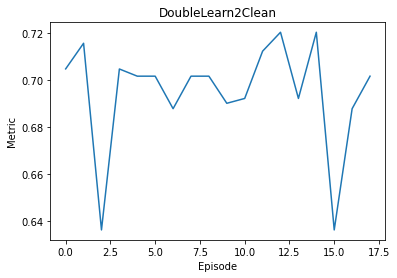

In [19]:


# Learn2clean finds the best strategy LOF -> CART for maximal accuracy : 0.7235772357723578 for CART
# in  234.35 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'CART', 'Survived', None, 'LOF -> CART', 'accuracy', 0.7235772357723578, 234.34766507148743)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='CART', target_goal='Survived',threshold = 0.6, target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

Start Learn2Clean
Learn2Clean - Pipeline construction -- CPU time: 0.1413419246673584 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> LDA

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.15386009216308594 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.20766687393188477 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.021149873733520508 seconds


>>Outlier detection and removal:
* For train dataset
1 outlying rows have been removed
* For test dataset
0 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.013663768768310547 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.701123595505618

Classification done -- CPU time: 0.023416996002197266 seconds
End Pipeline CPU time: 0.27803897857666016 seconds


Strategy# 2 : Greedy traversal for starting state KNN
KNN -> LDA

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 n

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.4575278759002686 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.6139189801985186

Classification done -- CPU time: 0.023914098739624023 seconds
End Pipeline CPU time: 1.4868638515472412 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> LDA

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
Afte

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m

... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02373814582824707 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01798081398010254 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.7058823529411764

Classification done -- CPU time: 0.022602081298828125 seconds
End Pipeline CPU time: 0.07252621650695801 seconds


Strategy# 6 : Greedy traversal for starting state ZS
ZS -> LOF -> LDA

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.021203041076660156 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires n

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m


Accuracy of LDA result for 10 cross-validation : 0.6974789915966386

Classification done -- CPU time: 0.022160053253173828 seconds
End Pipeline CPU time: 0.08307600021362305 seconds


Strategy# 8 : Greedy traversal for starting state WR
WR -> MF -> LDA

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply WR feature selection
Input variables must be non-negative. WR feature selection is only applied to positive variables.
After feature selection:
7 features remain
['SibSp', 'Fare', 'New_ID', 'Parch', 'Age', 'Pclass', 'PassengerId']
Feature selection done -- CPU time: 0.012948989868164062 seconds

>>Imputation 
* For train dataset
Before imputation:
No missing values in the given data
* For test dataset
Before imputation:
Total 264 missing values in ['Fare', 'Age']
- 264 numerical missing values in ['Fare', 'Age']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0.0 non-numerical missing values
Imputation done -- CPU tim

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m


Accuracy of LDA result for 10 cross-validation : 0.7181802944740981

Classification done -- CPU time: 0.025819063186645508 seconds
End Pipeline CPU time: 0.05369281768798828 seconds


Strategy# 11 : Greedy traversal for starting state ZSB
ZSB -> LDA

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
178 outlying rows have been removed:
* For test dataset
90 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.021687030792236328 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.7090909090909091

Classification done -- CPU time: 0.022964000701904297 seconds
End Pipeline CPU time: 0.05085897445678711 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> LDA

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_search.py:925: UserWarning: One or more of the test scores are non-finite: [nan]
  category=UserWarning
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-p

Constraints passing: 46

Constraints failing: 10

Consistency checking done -- CPU time: 0.05980634689331055 seconds

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.015636920928955078 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.6930109364319891

Classification done -- CPU time: 0.022831201553344727 seconds
End Pipeline CPU time: 0.10826706886291504 seconds


Strategy# 15 : Greedy traversal for starting state PC
PC -> ZSB -> LDA

Start pipeline
-------------
>>Consistency checking
* For train dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 891
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of patte

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.4851226806640625 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.6139189801985186

Classification done -- CPU time: 0.02357625961303711 seconds
End Pipeline CPU time: 1.5265581607818604 seconds


Strategy# 17 : Greedy traversal for starting state AD
AD -> ZS -> LOF -> LDA

Start pipeline
-------------

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.17737603187561035 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.022429943084716797 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so m

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m

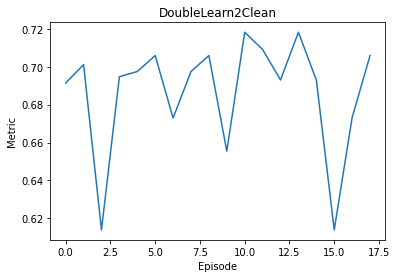

In [20]:
# Learn2clean finds the best strategy WR -> IQR -> LDA for maximal accuracy : 0.7398373983739838 for LDA 
# despite collinearity in  2.68 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'LDA', 'Survived', None, 'ZS -> LOF -> LDA', 'accuracy', 0.7398373983739838, 2.67972993850708)

l2c_c1assification2=ql.Qlearner(dataset,goal='LDA',target_goal='Survived',target_prepare=None, threshold = 0.6, file_name = 'titanic_example', verbose = False)
l2c_c1assification2.learn2clean()



Start Learn2Clean
Learn2Clean - Pipeline construction -- CPU time: 0.12327122688293457 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> NB

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.16058087348937988 seconds


>>Classification task
Accuracy of Naive Naive Bayes classification for 1

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.4325828552246094 seconds


>>Classification task
Accuracy of Naive Naive Bayes classification for 10 cross-validation : 0.5859051186017478

Classification done -- CPU time: 0.042665958404541016 seconds
End Pipeline CPU time: 1.480975866317749 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> NB

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin


>>Classification task
Accuracy of Naive Naive Bayes classification for 10 cross-validation : 0.6781818181818182

Classification done -- CPU time: 0.04508495330810547 seconds
End Pipeline CPU time: 0.07017278671264648 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> NB

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.017780065536499023 seconds


>>Classification task
Accuracy of Naive Naive Bayes classification for 10 cross-validation : 0.6675

Classification done -- CPU time: 0.047422170639038086 seconds
End Pipeline CPU time: 0.07129120826721191 seconds


Strategy# 13 : Greedy traversal for starting state IQR
IQR -> NB

Start pipelin

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.4206931591033936 seconds


>>Classification task
Accuracy of Naive Naive Bayes classification for 10 cross-validation : 0.5859051186017478

Classification done -- CPU time: 0.04093217849731445 seconds
End Pipeline CPU time: 1.4812123775482178 seconds


Strategy# 17 : Greedy traversal for starting state AD
AD -> ZS -> LOF -> NB

Start pipeline
-------------

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.20331525802612305 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.0223386287689209 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no mi

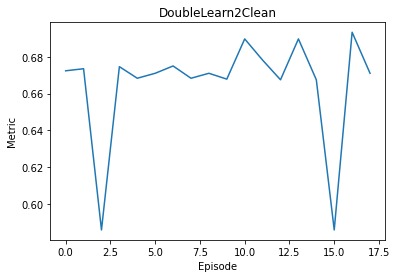

In [21]:
# Learn2clean finds the best strategy WR -> IQR -> NB for maximal accuracy : 0.7052631578947368 for NB
# in  2.96 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'NB', 'Survived', None, 'Tree -> IQR -> NB', 'accuracy', 0.7052631578947368, 2.9261510372161865)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='NB',target_goal='Survived',threshold = 0.6,target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

Start Learn2Clean
Learn2Clean - Pipeline construction -- CPU time: 0.1093897819519043 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> LASSO

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.20738697052001953 seconds


>>Regression task
Best alpha =  0.001
MSE of LASSO with 10  folds for 

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.4409122467041016 seconds


>>Regression task
Best alpha =  0.025
MSE of LASSO with 10  folds for cross-validation: 0.27181636114366337
Regression done -- CPU time: 0.020840883255004883 seconds
End Pipeline CPU time: 1.467824935913086 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> LASSO

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Em

30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.017201900482177734 seconds


>>Regression task
Best alpha =  0.001
MSE of LASSO with 10  folds for cross-validation: 0.23123945803625562
Regression done -- CPU time: 0.02317500114440918 seconds
End Pipeline CPU time: 0.10657715797424316 seconds


Strategy# 15 : Greedy traversal for starting state PC
PC -> ZSB -> LASSO

Start pipeline
-------------
>>Consistency checking
* For train dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 891
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for pattern# 0 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 1 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 2 : 247
No record from the dataset sati

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.4102048873901367 seconds


>>Regression task
Best alpha =  0.025
MSE of LASSO with 10  folds for cross-validation: 0.27181636114366337
Regression done -- CPU time: 0.022166013717651367 seconds
End Pipeline CPU time: 1.4515011310577393 seconds


Strategy# 17 : Greedy traversal for starting state AD
AD -> ZS -> LOF -> LASSO

Start pipeline
-------------

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.1920311450958252 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.022316932678222656 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no missin

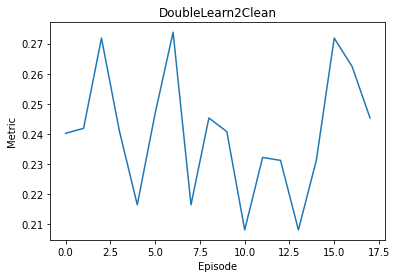

In [22]:
# Learn2clean finds the best strategy WR -> IQR -> NB for maximal accuracy : 0.7052631578947368 for NB
# in  2.96 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'NB', 'Survived', None, 'Tree -> IQR -> NB', 'accuracy', 0.7052631578947368, 2.9261510372161865)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='LASSO',target_goal='Survived',threshold = 0.6,target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

Start Learn2Clean
Learn2Clean - Pipeline construction -- CPU time: 0.11784696578979492 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> OLS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.18163824081420898 seconds


>>Regression task


const          1.160428
Age           -0.008579
Fare           0.000719
Parch          0.046999
PassengerId   -0.000036
Pclass        -0.224285
SibSp         -0.062187
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,22.000000,7.2500,0.0,1.0,3.0,1.0
1,1.0,38.000000,71.2833,0.0,2.0,1.0,1.0
2,1.0,26.000000,7.9250,0.0,3.0,3.0,0.0
3,1.0,35.000000,53.1000,0.0,4.0,1.0,1.0
4,1.0,35.000000,8.0500,0.0,5.0,3.0,0.0
...,...,...,...,...,...,...,...
1304,1.0,26.348953,8.0500,0.0,1305.0,3.0,0.0
1305,1.0,39.000000,108.9000,0.0,1306.0,1.0,0.0
1306,1.0,38.500000,7.2500,0.0,1307.0,3.0,0.0
1307,1.0,26.348018,8.0500,0.0,1308.0,3.0,0.0


(7,)

(1309, 7)

(7,)

(1309, 7)

MODIFICATION
Regression done -- CPU time: 0.02808403968811035 seconds
End Pipeline CPU time: 0.220001220703125 seconds


Strategy# 1 : Greedy traversal for starting state EM
EM -> MM -> IQR -> OLS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.21482324600219727 seconds

>>Normalization 
* For train dataset
... train dataset
* For test datase

const          0.839029
Age           -0.479461
Fare           0.470564
Parch          0.338812
PassengerId   -0.033146
Pclass        -0.389890
SibSp         -0.334543
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,0.335385,0.098010,0.000000,0.000000,1.0,0.125
1,1.0,0.518727,0.212363,0.000000,0.000765,0.0,0.125
2,1.0,0.381220,0.099215,0.000000,0.001529,1.0,0.000
3,1.0,0.484350,0.179891,0.000000,0.002294,0.0,0.125
4,1.0,0.484350,0.099438,0.000000,0.003058,1.0,0.000
...,...,...,...,...,...,...,...
1304,1.0,0.152031,0.099438,0.000000,0.996942,1.0,0.000
1305,1.0,0.530186,0.279540,0.000000,0.997706,0.0,0.000
1306,1.0,0.524456,0.098010,0.000000,0.998471,1.0,0.000
1307,1.0,0.325541,0.099438,0.000000,0.999235,1.0,0.000


(7,)

(1308, 7)

(7,)

(1308, 7)

MODIFICATION
Regression done -- CPU time: 0.025397062301635742 seconds
End Pipeline CPU time: 0.2828071117401123 seconds


Strategy# 2 : Greedy traversal for starting state KNN
KNN -> OLS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.2998881340026855 seconds


>>Regression task


const          0.450915
Age           -0.000377
Fare          -0.000377
Parch         -0.000377
PassengerId   -0.000377
Pclass        -0.000377
SibSp         -0.000377
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000
1,1.0,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000
2,1.0,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000
3,1.0,35.000000,35.000000,35.000000,35.000000,35.000000,35.000000
4,1.0,35.000000,35.000000,35.000000,35.000000,35.000000,35.000000
...,...,...,...,...,...,...,...
1304,1.0,29.423195,29.423195,29.423195,29.423195,29.423195,29.423195
1305,1.0,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000
1306,1.0,38.500000,38.500000,38.500000,38.500000,38.500000,38.500000
1307,1.0,36.739320,36.739320,36.739320,36.739320,36.739320,36.739320


(7,)

(1309, 7)

(7,)

(1309, 7)

MODIFICATION
Regression done -- CPU time: 0.03380417823791504 seconds
End Pipeline CPU time: 1.3398170471191406 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> OLS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
Imputation done -- CPU time: 0.05800604820251465 seconds


>>Regression task


const          1.070316
Age           -0.007349
Fare           0.000780
Parch          0.049035
PassengerId   -0.000032
Pclass        -0.209275
SibSp         -0.043759
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,22.0,7.2500,0,1,3,1
1,1.0,38.0,71.2833,0,2,1,1
2,1.0,26.0,7.9250,0,3,3,0
3,1.0,35.0,53.1000,0,4,1,1
4,1.0,35.0,8.0500,0,5,3,0
...,...,...,...,...,...,...,...
1304,1.0,24.0,8.0500,0,1305,3,0
1305,1.0,39.0,108.9000,0,1306,1,0
1306,1.0,38.5,7.2500,0,1307,3,0
1307,1.0,24.0,8.0500,0,1308,3,0


(7,)

(1309, 7)

(7,)

(1309, 7)

MODIFICATION
Regression done -- CPU time: 0.025043964385986328 seconds
End Pipeline CPU time: 0.08955907821655273 seconds


Strategy# 4 : Greedy traversal for starting state DS
DS -> IQR -> OLS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02833700180053711 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01600193977355957 seconds


>>Regression task


const          0.721672
Age           -0.313686
Fare           0.121626
Parch          0.122227
PassengerId    0.039737
Pclass        -0.428701
SibSp         -0.049177
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,0.296296,0.103943,0.000000,0.000000,1.0,0.777778
1,1.0,0.740741,0.865507,0.000000,0.000766,0.0,0.777778
2,1.0,0.444444,0.222222,0.000000,0.001533,1.0,0.000000
3,1.0,0.685185,0.811804,0.000000,0.002299,0.0,0.777778
4,1.0,0.685185,0.227616,0.000000,0.003065,1.0,0.000000
...,...,...,...,...,...,...,...
1300,1.0,0.019864,0.449694,0.777778,0.995238,1.0,0.777778
1302,1.0,0.722222,0.891659,0.000000,0.996825,0.0,0.777778
1303,1.0,0.500000,0.126984,0.000000,0.997619,1.0,0.000000
1305,1.0,0.759259,0.896508,0.000000,0.999206,0.0,0.000000


(7,)

(1045, 7)

(7,)

(1045, 7)

MODIFICATION
Regression done -- CPU time: 0.023843050003051758 seconds
End Pipeline CPU time: 0.07657003402709961 seconds


Strategy# 5 : Greedy traversal for starting state MM
MM -> IQR -> OLS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02125716209411621 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.017415761947631836 seconds


>>Regression task


const          0.933074
Age           -0.682685
Fare           0.286359
Parch          0.293870
PassengerId    0.026339
Pclass        -0.485845
SibSp         -0.283672
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,0.273456,0.014151,0.000000,0.000000,1.0,0.125
1,1.0,0.473882,0.139136,0.000000,0.000766,0.0,0.125
2,1.0,0.323563,0.015469,0.000000,0.001531,1.0,0.000
3,1.0,0.436302,0.103644,0.000000,0.002297,0.0,0.125
4,1.0,0.436302,0.015713,0.000000,0.003063,1.0,0.000
...,...,...,...,...,...,...,...
1300,1.0,0.035450,0.026887,0.166667,0.995406,1.0,0.125
1302,1.0,0.461355,0.175668,0.000000,0.996937,0.0,0.125
1303,1.0,0.348616,0.015176,0.000000,0.997703,1.0,0.000
1305,1.0,0.486409,0.212559,0.000000,0.999234,0.0,0.000


(7,)

(1045, 7)

(7,)

(1045, 7)

MODIFICATION
Regression done -- CPU time: 0.023597002029418945 seconds
End Pipeline CPU time: 0.07146167755126953 seconds


Strategy# 6 : Greedy traversal for starting state ZS
ZS -> LOF -> OLS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.020188093185424805 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.017766237258911133 seconds


>>Regression task


const          0.623520
Age           -0.128998
Fare           0.036337
Parch         -0.052332
PassengerId    0.067864
Pclass        -0.072010
SibSp          0.113129
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
1,1.0,0.563282,0.733941,-0.444829,-1.727422,-1.545507,0.481104
3,1.0,0.355144,0.382632,-0.444829,-1.722131,-1.545507,0.481104
6,1.0,1.673353,0.358723,-0.444829,-1.714195,-1.545507,-0.478904
10,1.0,-1.795619,-0.320632,0.710492,-1.703613,0.841595,0.481104
21,1.0,0.285764,-0.392117,-0.444829,-1.674514,-0.351956,-0.478904
...,...,...,...,...,...,...,...
1295,1.0,0.910179,-0.107705,-0.444829,1.695677,-1.545507,0.481104
1296,1.0,-0.685548,-0.375454,-0.444829,1.698323,-0.351956,-0.478904
1298,1.0,1.395835,3.442989,0.710492,1.703613,-1.545507,0.481104
1302,1.0,0.493903,1.095556,-0.444829,1.714195,-1.545507,0.481104


(7,)

(240, 7)

(7,)

(240, 7)

MODIFICATION
Regression done -- CPU time: 0.024496078491210938 seconds
End Pipeline CPU time: 0.0726161003112793 seconds


Strategy# 7 : Greedy traversal for starting state MR
MR -> DS -> IQR -> OLS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
11 features 
Apply MR feature selection with missing threshold= 0.3
1 features with greater than 0.30 missing values.

List of variables to be removed : ['Cabin']
After feature selection:
10 features remain
['SibSp', 'Fare', 'PassengerId', 'Embarked', 'Ticket', 'Parch', 'Age', 'Sex', 'Pclass', 'Name']
Feature selection done -- CPU time: 0.0063059329986572266 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02502918243408203 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.016802

const          0.721672
Age           -0.313686
Fare           0.121626
Parch          0.122227
PassengerId    0.039737
Pclass        -0.428701
SibSp         -0.049177
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,0.296296,0.103943,0.000000,0.000000,1.0,0.777778
1,1.0,0.740741,0.865507,0.000000,0.000766,0.0,0.777778
2,1.0,0.444444,0.222222,0.000000,0.001533,1.0,0.000000
3,1.0,0.685185,0.811804,0.000000,0.002299,0.0,0.777778
4,1.0,0.685185,0.227616,0.000000,0.003065,1.0,0.000000
...,...,...,...,...,...,...,...
1300,1.0,0.019864,0.449694,0.777778,0.995238,1.0,0.777778
1302,1.0,0.722222,0.891659,0.000000,0.996825,0.0,0.777778
1303,1.0,0.500000,0.126984,0.000000,0.997619,1.0,0.000000
1305,1.0,0.759259,0.896508,0.000000,0.999206,0.0,0.000000


(7,)

(1045, 7)

(7,)

(1045, 7)

MODIFICATION
Regression done -- CPU time: 0.024448871612548828 seconds
End Pipeline CPU time: 0.08664298057556152 seconds


Strategy# 8 : Greedy traversal for starting state WR
WR -> MF -> OLS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
11 features 
Apply WR feature selection
Input variables must be non-negative. WR feature selection is only applied to positive variables.
After feature selection:
6 features remain
['SibSp', 'Fare', 'Parch', 'Age', 'Pclass', 'PassengerId']
Feature selection done -- CPU time: 0.011345863342285156 seconds

>>Imputation 
* For train dataset
Before imputation:
No missing values in the given data
* For test dataset
Before imputation:
Total 264 missing values in ['Fare', 'Age']
- 264 numerical missing values in ['Fare', 'Age']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0.0 non-numerical missing values
Imputation done -- CPU time: 0.021167755126953125 seconds


>>Regression task


const          1.179570
Age           -0.008579
Fare           0.000559
Parch          0.048978
PassengerId    0.000030
Pclass        -0.242923
SibSp         -0.056734
dtype: float64

,const,SibSp,Fare,Parch,Age,Pclass,PassengerId
0,1.0,1,7.2500,0,22.0,3,1
1,1.0,1,71.2833,0,38.0,1,2
2,1.0,0,7.9250,0,26.0,3,3
3,1.0,1,53.1000,0,35.0,1,4
4,1.0,0,8.0500,0,35.0,3,5
...,...,...,...,...,...,...,...
1304,1.0,0,8.0500,0,24.0,3,1305
1305,1.0,0,108.9000,0,39.0,1,1306
1306,1.0,0,7.2500,0,38.5,3,1307
1307,1.0,0,8.0500,0,24.0,3,1308


(7,)

(1309, 7)

(7,)

(1309, 7)

MODIFICATION
Regression done -- CPU time: 0.03146481513977051 seconds
End Pipeline CPU time: 0.0752267837524414 seconds


Strategy# 9 : Greedy traversal for starting state LC
LC -> MF -> OLS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
11 features 
Apply LC feature selection with threshold= 0.3
2 features with linear correlation greater than 0.30.

List of correlated variables to be removed : ['Pclass', 'SibSp']
After feature selection:
9 features remain
['Fare', 'PassengerId', 'Embarked', 'Ticket', 'Parch', 'Age', 'Sex', 'Cabin', 'Name']
Feature selection done -- CPU time: 0.013710975646972656 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Tot

const          0.385827
Parch          0.007516
Age           -0.002914
Fare           0.002577
PassengerId   -0.000010
dtype: float64

,const,Fare,PassengerId,Parch,Age
0,1.0,7.2500,1,0,22.0
1,1.0,71.2833,2,0,38.0
2,1.0,7.9250,3,0,26.0
3,1.0,53.1000,4,0,35.0
4,1.0,8.0500,5,0,35.0
...,...,...,...,...,...
1304,1.0,8.0500,1305,0,24.0
1305,1.0,108.9000,1306,0,39.0
1306,1.0,7.2500,1307,0,38.5
1307,1.0,8.0500,1308,0,24.0


(5,)

(1309, 5)

(5,)

(1309, 5)

MODIFICATION
Regression done -- CPU time: 0.025340795516967773 seconds
End Pipeline CPU time: 0.10047411918640137 seconds


Strategy# 10 : Greedy traversal for starting state Tree
Tree -> IQR -> OLS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
212 outlying rows have been removed
* For test dataset
297 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.020805835723876953 seconds


>>Regression task


const          0.903281
Age           -0.008966
Fare           0.005144
Parch          0.188701
PassengerId   -0.000027
Pclass        -0.158930
SibSp         -0.018270
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,22.0,7.2500,0,1,3,1
2,1.0,26.0,7.9250,0,3,3,0
3,1.0,35.0,53.1000,0,4,1,1
4,1.0,35.0,8.0500,0,5,3,0
6,1.0,54.0,51.8625,0,7,1,0
...,...,...,...,...,...,...,...
1296,1.0,20.0,13.8625,0,1297,2,0
1297,1.0,23.0,10.5000,0,1298,2,1
1300,1.0,3.0,13.7750,1,1301,3,1
1303,1.0,28.0,7.7750,0,1304,3,0


(7,)

(779, 7)

(7,)

(779, 7)

MODIFICATION
Regression done -- CPU time: 0.02414989471435547 seconds
End Pipeline CPU time: 0.054383039474487305 seconds


Strategy# 11 : Greedy traversal for starting state ZSB
ZSB -> OLS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
338 outlying rows have been removed:
* For test dataset
398 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.02267003059387207 seconds


>>Regression task


const          0.773296
Age           -0.006640
Fare           0.008472
Parch          0.079322
PassengerId   -0.000116
Pclass        -0.130034
SibSp         -0.037262
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,22.0,7.2500,0,1,3,1
2,1.0,26.0,7.9250,0,3,3,0
4,1.0,35.0,8.0500,0,5,3,0
6,1.0,54.0,51.8625,0,7,1,0
8,1.0,27.0,11.1333,2,9,3,0
...,...,...,...,...,...,...,...
1294,1.0,17.0,47.1000,0,1295,1,0
1296,1.0,20.0,13.8625,0,1297,2,0
1303,1.0,28.0,7.7750,0,1304,3,0
1305,1.0,39.0,108.9000,0,1306,1,0


(7,)

(677, 7)

(7,)

(677, 7)

MODIFICATION
Regression done -- CPU time: 0.025138139724731445 seconds
End Pipeline CPU time: 0.05463004112243652 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> OLS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01942300796508789 seconds


>>Regression task


const          0.839676
Age           -0.007753
Fare           0.000614
Parch         -0.063440
PassengerId    0.000215
Pclass        -0.036349
SibSp          0.061257
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
1,1.0,38.0,71.2833,0,2,1,1
3,1.0,35.0,53.1000,0,4,1,1
6,1.0,54.0,51.8625,0,7,1,0
10,1.0,4.0,16.7000,1,11,3,1
21,1.0,34.0,13.0000,0,22,2,0
...,...,...,...,...,...,...,...
1295,1.0,43.0,27.7208,0,1296,1,1
1296,1.0,20.0,13.8625,0,1297,2,0
1298,1.0,50.0,211.5000,1,1299,1,1
1302,1.0,37.0,90.0000,0,1303,1,1


(7,)

(240, 7)

(7,)

(240, 7)

MODIFICATION
Regression done -- CPU time: 0.0231778621673584 seconds
End Pipeline CPU time: 0.04932212829589844 seconds


Strategy# 13 : Greedy traversal for starting state IQR
IQR -> OLS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
212 outlying rows have been removed
* For test dataset
297 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.02630305290222168 seconds


>>Regression task


const          0.903281
Age           -0.008966
Fare           0.005144
Parch          0.188701
PassengerId   -0.000027
Pclass        -0.158930
SibSp         -0.018270
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,22.0,7.2500,0,1,3,1
2,1.0,26.0,7.9250,0,3,3,0
3,1.0,35.0,53.1000,0,4,1,1
4,1.0,35.0,8.0500,0,5,3,0
6,1.0,54.0,51.8625,0,7,1,0
...,...,...,...,...,...,...,...
1296,1.0,20.0,13.8625,0,1297,2,0
1297,1.0,23.0,10.5000,0,1298,2,1
1300,1.0,3.0,13.7750,1,1301,3,1
1303,1.0,28.0,7.7750,0,1304,3,0


(7,)

(779, 7)

(7,)

(779, 7)

MODIFICATION
Regression done -- CPU time: 0.02535700798034668 seconds
End Pipeline CPU time: 0.059114933013916016 seconds


Strategy# 14 : Greedy traversal for starting state CC
CC -> LOF -> OLS

Start pipeline
-------------
>>Consistency checking
* For train dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 51

Constraints failing: 5

* For test dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 46

Constraints failing: 10

Consistency checking done -- CPU time: 0.06796026229858398 seconds

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01618790626525879 seconds


>>Regression task


const          0.839676
Age           -0.007753
Fare           0.000614
Parch         -0.063440
PassengerId    0.000215
Pclass        -0.036349
SibSp          0.061257
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
1,1.0,38.0,71.2833,0,2,1,1
6,1.0,54.0,51.8625,0,7,1,0
10,1.0,4.0,16.7000,1,11,3,1
21,1.0,34.0,13.0000,0,22,2,0
23,1.0,28.0,35.5000,0,24,1,0
...,...,...,...,...,...,...,...
871,1.0,47.0,52.5542,1,872,1,1
872,1.0,33.0,5.0000,0,873,1,0
879,1.0,56.0,83.1583,1,880,1,0
887,1.0,19.0,30.0000,0,888,1,0


(7,)

(153, 7)

(7,)

(153, 7)

MODIFICATION
Regression done -- CPU time: 0.02301311492919922 seconds
End Pipeline CPU time: 0.11576390266418457 seconds


Strategy# 15 : Greedy traversal for starting state PC
PC -> ZSB -> OLS

Start pipeline
-------------
>>Consistency checking
* For train dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 891
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for pattern# 0 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 1 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 2 : 247
No record from the dataset satisfied the patterns!
Will return empty dataset - please change our patterns
* For test dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 1309
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for pattern# 0 : 272
Number of pattern violations on variable 

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.2618088722229004 seconds


>>Regression task


const          0.450915
Age           -0.000377
Fare          -0.000377
Parch         -0.000377
PassengerId   -0.000377
Pclass        -0.000377
SibSp         -0.000377
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000
1,1.0,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000
2,1.0,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000
3,1.0,35.000000,35.000000,35.000000,35.000000,35.000000,35.000000
4,1.0,35.000000,35.000000,35.000000,35.000000,35.000000,35.000000
...,...,...,...,...,...,...,...
1304,1.0,29.423195,29.423195,29.423195,29.423195,29.423195,29.423195
1305,1.0,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000
1306,1.0,38.500000,38.500000,38.500000,38.500000,38.500000,38.500000
1307,1.0,36.739320,36.739320,36.739320,36.739320,36.739320,36.739320


(7,)

(1309, 7)

(7,)

(1309, 7)

MODIFICATION
Regression done -- CPU time: 0.026147127151489258 seconds
End Pipeline CPU time: 1.309765100479126 seconds


Strategy# 17 : Greedy traversal for starting state AD
AD -> ZS -> LOF -> OLS

Start pipeline
-------------

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.19734716415405273 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.022310972213745117 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done --

const          0.623520
Age           -0.128998
Fare           0.036337
Parch         -0.052332
PassengerId    0.067864
Pclass        -0.072010
SibSp          0.113129
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
1,1.0,0.563282,0.733941,-0.444829,-1.727422,-1.545507,0.481104
3,1.0,0.355144,0.382632,-0.444829,-1.722131,-1.545507,0.481104
6,1.0,1.673353,0.358723,-0.444829,-1.714195,-1.545507,-0.478904
10,1.0,-1.795619,-0.320632,0.710492,-1.703613,0.841595,0.481104
21,1.0,0.285764,-0.392117,-0.444829,-1.674514,-0.351956,-0.478904
...,...,...,...,...,...,...,...
1295,1.0,0.910179,-0.107705,-0.444829,1.695677,-1.545507,0.481104
1296,1.0,-0.685548,-0.375454,-0.444829,1.698323,-0.351956,-0.478904
1298,1.0,1.395835,3.442989,0.710492,1.703613,-1.545507,0.481104
1302,1.0,0.493903,1.095556,-0.444829,1.714195,-1.545507,0.481104


(7,)

(240, 7)

(7,)

(240, 7)

MODIFICATION
Regression done -- CPU time: 0.024692058563232422 seconds
End Pipeline CPU time: 0.2738680839538574 seconds

Start pipeline
-------------

>>Regression task


const          1.179570
Age           -0.008579
Fare           0.000559
Parch          0.048978
PassengerId    0.000015
Pclass        -0.242923
SibSp         -0.056734
New_ID         0.000015
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp,New_ID
0,1.0,22.0,7.2500,0,1,3,1,1
1,1.0,38.0,71.2833,0,2,1,1,2
2,1.0,26.0,7.9250,0,3,3,0,3
3,1.0,35.0,53.1000,0,4,1,1,4
4,1.0,35.0,8.0500,0,5,3,0,5
...,...,...,...,...,...,...,...,...
1300,1.0,3.0,13.7750,1,1301,3,1,1301
1302,1.0,37.0,90.0000,0,1303,1,1,1303
1303,1.0,28.0,7.7750,0,1304,3,0,1304
1305,1.0,39.0,108.9000,0,1306,1,0,1306


(8,)

(1045, 8)

(8,)

(1045, 8)

MODIFICATION
Regression done -- CPU time: 0.02722907066345215 seconds
End Pipeline CPU time: 0.031481266021728516 seconds

==== Recap ====

List of strategies tried by Learn2Clean:
['MICE -> OLS', 'EM -> MM -> IQR -> OLS', 'KNN -> OLS', 'MF -> OLS', 'DS -> IQR -> OLS', 'MM -> IQR -> OLS', 'ZS -> LOF -> OLS', 'MR -> DS -> IQR -> OLS', 'WR -> MF -> OLS', 'LC -> MF -> OLS', 'Tree -> IQR -> OLS', 'ZSB -> OLS', 'LOF -> OLS', 'IQR -> OLS', 'CC -> LOF -> OLS', 'PC -> ZSB -> OLS', 'ED -> KNN -> OLS', 'AD -> ZS -> LOF -> OLS']

List of corresponding quality metrics ****
 [{'quality_metric': 0.23677221654749742}, {'quality_metric': 0.23687263811124729}, {'quality_metric': 0.23677221654749742}, {'quality_metric': 0.23677221654749742}, {'quality_metric': 0.24153279825254081}, {'quality_metric': 0.24153279825254081}, {'quality_metric': 0.2191262469900241}, {'quality_metric': 0.24153279825254081}, {'quality_metric': 0.24153279825254081}, {'quality_metric': 0.23677221654749742}, {'quality_metric': 0.

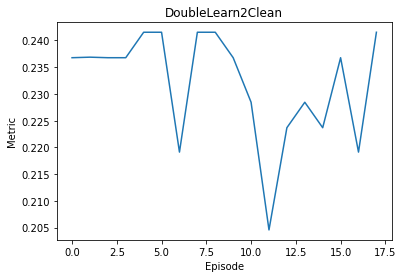

In [23]:
import learn2clean.loading.reader as rd 
import learn2clean.qlearning.qlearner as ql
# the results of learn2clean cleaning are stored in 'titanic_example'_results.txt in 'save' directory

titanic = ["../datasets/titanic/titanic_train.csv","../datasets/titanic/test.csv"]
hr=rd.Reader(sep=',',verbose=False, encoding=False) 
dataset=hr.train_test_split(titanic, 'Survived')

# Learn2clean finds the best strategy WR -> IQR -> NB for maximal accuracy : 0.7052631578947368 for NB
# in  2.96 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'NB', 'Survived', None, 'Tree -> IQR -> NB', 'accuracy', 0.7052631578947368, 2.9261510372161865)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='OLS',target_goal='Survived',threshold = 0.6,target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

Start Learn2Clean
Learn2Clean - Pipeline construction -- CPU time: 0.14302372932434082 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> MARS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.21308112144470215 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

MSE of MARS with 10 folds for cross-validation: 0.3138415661083148
Regression done -- CPU time: 1.8393151760101318 seconds
End Pipeline CPU time: 2.0675039291381836 seconds


Strategy# 1 : Greedy traversal for starting state EM
EM -> MM -> IQR -> MARS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.25020265579223633 seconds

>>Normalization 


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

MSE of MARS with 10 folds for cross-validation: 0.3160452553161267
Regression done -- CPU time: 0.6830360889434814 seconds
End Pipeline CPU time: 0.9911091327667236 seconds


Strategy# 2 : Greedy traversal for starting state KNN
KNN -> MARS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.5866937637329102 seconds


>>Regression task
MSE of MARS with 10 folds for cross-validation: 0.3355304915513617
Regression done -- CPU time: 0.11984682083129883 seconds
End Pipeline CPU time: 1.7151870727539062 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> MARS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputatio

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

MSE of MARS with 10 folds for cross-validation: 0.314351743650153
Regression done -- CPU time: 0.7085249423980713 seconds
End Pipeline CPU time: 0.7769789695739746 seconds


Strategy# 4 : Greedy traversal for starting state DS
DS -> IQR -> MARS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.033067941665649414 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01978898048400879 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

MSE of MARS with 10 folds for cross-validation: 0.3181130073223285
Regression done -- CPU time: 2.844001054763794 seconds
End Pipeline CPU time: 2.9080121517181396 seconds


Strategy# 5 : Greedy traversal for starting state MM
MM -> IQR -> MARS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.023553133010864258 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.019906044006347656 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

MSE of MARS with 10 folds for cross-validation: 0.31651820813071757
Regression done -- CPU time: 0.8258228302001953 seconds
End Pipeline CPU time: 0.8793730735778809 seconds


Strategy# 6 : Greedy traversal for starting state ZS
ZS -> LOF -> MARS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.024476289749145508 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.02350926399230957 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

MSE of MARS with 10 folds for cross-validation: 0.32114174609486335
Regression done -- CPU time: 2.5631179809570312 seconds
End Pipeline CPU time: 2.6223039627075195 seconds


Strategy# 7 : Greedy traversal for starting state MR
MR -> DS -> IQR -> MARS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
11 features 
Apply MR feature selection with missing threshold= 0.3
1 features with greater than 0.30 missing values.

List of variables to be removed : ['Cabin']
After feature selection:
10 features remain
['SibSp', 'Fare', 'PassengerId', 'Embarked', 'Ticket', 'Parch', 'Age', 'Sex', 'Pclass', 'Name']
Feature selection done -- CPU time: 0.005403757095336914 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.03426384925842285 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Out

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

MSE of MARS with 10 folds for cross-validation: 0.3181130073223285
Regression done -- CPU time: 2.747809886932373 seconds
End Pipeline CPU time: 2.822932004928589 seconds


Strategy# 8 : Greedy traversal for starting state WR
WR -> MF -> MARS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
11 features 
Apply WR feature selection
Input variables must be non-negative. WR feature selection is only applied to positive variables.
After feature selection:
6 features remain
['SibSp', 'Fare', 'Parch', 'Age', 'Pclass', 'PassengerId']
Feature selection done -- CPU time: 0.01697707176208496 seconds

>>Imputation 
* For train dataset
Before imputation:
No missing values in the given data
* For test dataset
Before imputation:
Total 264 missing values in ['Fare', 'Age']
- 264 numerical missing values in ['Fare', 'Age']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0.0 non-numerical missing values
Imputation done -- CPU time: 0.02290391921997070

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

MSE of MARS with 10 folds for cross-validation: 0.3163411289963457
Regression done -- CPU time: 0.8294110298156738 seconds
End Pipeline CPU time: 0.8790678977966309 seconds


Strategy# 9 : Greedy traversal for starting state LC
LC -> MF -> MARS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
11 features 
Apply LC feature selection with threshold= 0.3
2 features with linear correlation greater than 0.30.

List of correlated variables to be removed : ['Pclass', 'SibSp']
After feature selection:
9 features remain
['Fare', 'PassengerId', 'Embarked', 'Ticket', 'Parch', 'Age', 'Sex', 'Cabin', 'Name']
Feature selection done -- CPU time: 0.014132022857666016 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical mi

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

MSE of MARS with 10 folds for cross-validation: 0.3274763101845115
Regression done -- CPU time: 0.31360697746276855 seconds
End Pipeline CPU time: 0.4079289436340332 seconds


Strategy# 10 : Greedy traversal for starting state Tree
Tree -> IQR -> MARS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
212 outlying rows have been removed
* For test dataset
297 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.024965286254882812 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

MSE of MARS with 10 folds for cross-validation: 0.3061914715080636
Regression done -- CPU time: 1.3313360214233398 seconds
End Pipeline CPU time: 1.3677020072937012 seconds


Strategy# 11 : Greedy traversal for starting state ZSB
ZSB -> MARS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
338 outlying rows have been removed:
* For test dataset
398 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.029937028884887695 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

MSE of MARS with 10 folds for cross-validation: 0.30522838392977525
Regression done -- CPU time: 14.575522899627686 seconds
End Pipeline CPU time: 14.612866163253784 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> MARS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.020023822784423828 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

MSE of MARS with 10 folds for cross-validation: 0.33485401129029685
Regression done -- CPU time: 2.6850502490997314 seconds
End Pipeline CPU time: 2.7119569778442383 seconds


Strategy# 13 : Greedy traversal for starting state IQR
IQR -> MARS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
212 outlying rows have been removed
* For test dataset
297 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.024363994598388672 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

MSE of MARS with 10 folds for cross-validation: 0.3061914715080636
Regression done -- CPU time: 1.3718481063842773 seconds
End Pipeline CPU time: 1.40236496925354 seconds


Strategy# 14 : Greedy traversal for starting state CC
CC -> LOF -> MARS

Start pipeline
-------------
>>Consistency checking
* For train dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 51

Constraints failing: 5

* For test dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 46

Constraints failing: 10

Consistency checking done -- CPU time: 0.07814764976501465 seconds

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.017518043518066406 secon

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

MSE of MARS with 10 folds for cross-validation: 0.33485401129029685
Regression done -- CPU time: 2.617478847503662 seconds
End Pipeline CPU time: 2.722402811050415 seconds


Strategy# 15 : Greedy traversal for starting state PC
PC -> ZSB -> MARS

Start pipeline
-------------
>>Consistency checking
* For train dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 891
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for pattern# 0 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 1 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 2 : 247
No record from the dataset satisfied the patterns!
Will return empty dataset - please change our patterns
* For test dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 1309
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for patter

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.421492099761963 seconds


>>Regression task
MSE of MARS with 10 folds for cross-validation: 0.3355304915513617
Regression done -- CPU time: 0.10821723937988281 seconds
End Pipeline CPU time: 1.547842264175415 seconds


Strategy# 17 : Greedy traversal for starting state AD
AD -> ZS -> LOF -> MARS

Start pipeline
-------------

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 1.3922741413116455 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.021919965744018555 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01516413688659668 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an em

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

MSE of MARS with 10 folds for cross-validation: 0.32114174609486335
Regression done -- CPU time: 2.617892026901245 seconds
End Pipeline CPU time: 4.059686183929443 seconds

Start pipeline
-------------

>>Regression task


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

MSE of MARS with 10 folds for cross-validation: 0.3163411289963457
Regression done -- CPU time: 0.868182897567749 seconds
End Pipeline CPU time: 0.8720028400421143 seconds

==== Recap ====

List of strategies tried by Learn2Clean:
['MICE -> MARS', 'EM -> MM -> IQR -> MARS', 'KNN -> MARS', 'MF -> MARS', 'DS -> IQR -> MARS', 'MM -> IQR -> MARS', 'ZS -> LOF -> MARS', 'MR -> DS -> IQR -> MARS', 'WR -> MF -> MARS', 'LC -> MF -> MARS', 'Tree -> IQR -> MARS', 'ZSB -> MARS', 'LOF -> MARS', 'IQR -> MARS', 'CC -> LOF -> MARS', 'PC -> ZSB -> MARS', 'ED -> KNN -> MARS', 'AD -> ZS -> LOF -> MARS']

List of corresponding quality metrics ****
 [{'quality_metric': 0.3138415661083148}, {'quality_metric': 0.3160452553161267}, {'quality_metric': 0.3355304915513617}, {'quality_metric': 0.314351743650153}, {'quality_metric': 0.3181130073223285}, {'quality_metric': 0.31651820813071757}, {'quality_metric': 0.32114174609486335}, {'quality_metric': 0.3181130073223285}, {'quality_metric': 0.3163411289963457}, {

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

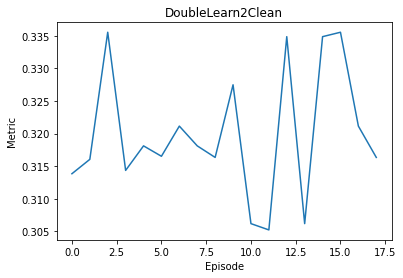

In [31]:
# Learn2clean finds the best strategy WR -> IQR -> NB for maximal accuracy : 0.7052631578947368 for NB
# in  2.96 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'NB', 'Survived', None, 'Tree -> IQR -> NB', 'accuracy', 0.7052631578947368, 2.9261510372161865)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='MARS',target_goal='Survived',threshold = 0.6,target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

Start Learn2Clean
Learn2Clean - Pipeline construction -- CPU time: 0.12358212471008301 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> HCA

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.27117228507995605 seconds


>>Clustering task
Note: The clustering is applied on the training datas

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.4787662029266357 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.6064  for k= 2
Quality of clustering 0.6064
Clustering done -- CPU time: 0.11327886581420898 seconds
End Pipeline CPU time: 1.5994439125061035 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> HCA

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numeric


>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.562  for k= 2
Quality of clustering 0.562
Clustering done -- CPU time: 0.029117345809936523 seconds
End Pipeline CPU time: 0.05594015121459961 seconds


Strategy# 13 : Greedy traversal for starting state IQR
IQR -> HCA

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
176 outlying rows have been removed
* For test dataset
239 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.021721839904785156 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.5478  for k= 4
Quality of clustering 0.5478
Clustering done -- CPU time: 0.05755186080932617 seconds
End Pipeline CPU time: 0.0862421989440918 seconds


Strategy# 14 : Greedy traversal for starting state CC
CC -> LOF -> HCA

Start pipeline
-------------
>>Consistency checking
* For train dataset
Constraints from the file: ti

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.475036859512329 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.6064  for k= 2
Quality of clustering 0.6064
Clustering done -- CPU time: 0.11278891563415527 seconds
End Pipeline CPU time: 1.616539716720581 seconds


Strategy# 17 : Greedy traversal for starting state AD
AD -> ZS -> LOF -> HCA

Start pipeline
-------------

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.19503092765808105 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.022068023681640625 seconds


>>Outlier detection and removal:
* For trai

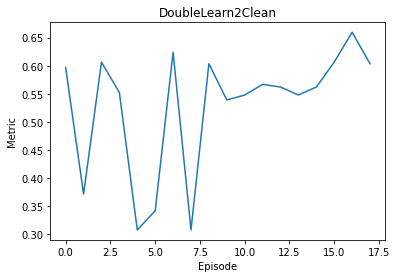

In [25]:
# Learn2clean finds the best strategy WR -> IQR -> NB for maximal accuracy : 0.7052631578947368 for NB
# in  2.96 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'NB', 'Survived', None, 'Tree -> IQR -> NB', 'accuracy', 0.7052631578947368, 2.9261510372161865)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='HCA',target_goal='Survived',threshold = 0.6,target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

Start Learn2Clean
Learn2Clean - Pipeline construction -- CPU time: 0.12622904777526855 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> KMEANS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.1774430274963379 seconds


>>Clustering task
Note: The clustering is applied on the training dat

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.6066  for k= 2
Quality of clustering 0.6066
Clustering done -- CPU time: 0.27496790885925293 seconds
End Pipeline CPU time: 0.4589118957519531 seconds


Strategy# 1 : Greedy traversal for starting state EM
EM -> MM -> IQR -> KMEANS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.2338728904724121 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.018501758575439453 seconds


>>Outlier detection and removal:
* For train dataset
0 outlying rows have been removed
* For test dataset
0 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.014860868453979492 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.383  for k= 3
Quality of clustering 0.383
Clustering done -- CPU time: 0.2469191551208496 seconds
End Pipeline CPU time: 0.5271329879760742 seconds


Strategy# 2 : Greedy traversal for starting state KNN
KNN -> KMEANS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.468250036239624 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.5589  for k= 5


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)


Quality of clustering 0.558
Clustering done -- CPU time: 0.229445219039917 seconds
End Pipeline CPU time: 1.7063469886779785 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> KMEANS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
Imputation done -- CPU time: 0.07169389724731445 seconds


>>Clustering task
Note: The clustering is applied on the training dataset onl

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.6067  for k= 2
Quality of clustering 0.6067
Clustering done -- CPU time: 0.28499317169189453 seconds
End Pipeline CPU time: 0.3659701347351074 seconds


Strategy# 4 : Greedy traversal for starting state DS
DS -> IQR -> KMEANS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.029793977737426758 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.020686626434326172 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.2971  for k= 3
Quality of clustering 0.2971
Clustering done -- CPU time: 0.24600720405578613 seconds
End Pipeline CPU time: 0.30835795402526855 seconds


Strategy# 5 : Greedy traversal for starting state MM
MM -> IQR -> KMEANS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02544689178466797 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01875901222229004 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.3497  for k= 3
Quality of clustering 0.3497
Clustering done -- CPU time: 0.22180604934692383 seconds
End Pipeline CPU time: 0.2770721912384033 seconds


Strategy# 6 : Greedy traversal for starting state ZS
ZS -> LOF -> KMEANS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.027665138244628906 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.020413875579833984 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.3892  for k= 2


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Quality of clustering 0.3892
Clustering done -- CPU time: 0.11981987953186035 seconds
End Pipeline CPU time: 0.17929887771606445 seconds


Strategy# 7 : Greedy traversal for starting state MR
MR -> DS -> IQR -> KMEANS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply MR feature selection with missing threshold= 0.3
1 features with greater than 0.30 missing values.

List of variables to be removed : ['Cabin']
After feature selection:
12 features remain
['SibSp', 'Fare', 'New_ID', 'row', 'Embarked', 'PassengerId', 'Ticket', 'Parch', 'Age', 'Sex', 'Pclass', 'Name']
Feature selection done -- CPU time: 0.007256984710693359 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.04167485237121582 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.2971  for k= 3
Quality of clustering 0.2971
Clustering done -- CPU time: 0.23231101036071777 seconds
End Pipeline CPU time: 0.32416272163391113 seconds


Strategy# 8 : Greedy traversal for starting state WR
WR -> MF -> KMEANS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply WR feature selection
Input variables must be non-negative. WR feature selection is only applied to positive variables.
After feature selection:
7 features remain
['SibSp', 'Fare', 'New_ID', 'Parch', 'Age', 'Pclass', 'PassengerId']
Feature selection done -- CPU time: 0.012767791748046875 seconds

>>Imputation 
* For train dataset
Before imputation:
No missing values in the given data
* For test dataset
Before imputation:
Total 264 missing values in ['Fare', 'Age']
- 264 numerical missing values in ['Fare', 'Age']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0.0 non-numerical missing values
Imputation done -- CPU time: 0.024

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.6104  for k= 2
Quality of clustering 0.6104
Clustering done -- CPU time: 0.22908306121826172 seconds
End Pipeline CPU time: 0.27630019187927246 seconds


Strategy# 9 : Greedy traversal for starting state LC
LC -> MF -> KMEANS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply LC feature selection with threshold= 0.3
3 features with linear correlation greater than 0.30.

List of correlated variables to be removed : ['Pclass', 'SibSp', 'New_ID']
After feature selection:
10 features remain
['Fare', 'PassengerId', 'row', 'Embarked', 'Ticket', 'Parch', 'Age', 'Sex', 'Cabin', 'Name']
Feature selection done -- CPU time: 0.016041040420532227 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.5951  for k= 2
Quality of clustering 0.5951
Clustering done -- CPU time: 0.26662707328796387 seconds
End Pipeline CPU time: 0.3562040328979492 seconds


Strategy# 10 : Greedy traversal for starting state Tree
Tree -> IQR -> KMEANS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
176 outlying rows have been removed
* For test dataset
239 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.022880077362060547 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.623  for k= 2
Quality of clustering 0.623
Clustering done -- CPU time: 0.22785592079162598 seconds
End Pipeline CPU time: 0.26166296005249023 seconds


Strategy# 11 : Greedy traversal for starting state ZSB
ZSB -> KMEANS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
178 outlying rows have been removed:
* For test dataset
90 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.025521039962768555 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.6226  for k= 2
Quality of clustering 0.6226
Clustering done -- CPU time: 0.22005820274353027 seconds
End Pipeline CPU time: 0.2535710334777832 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> KMEANS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.020400047302246094 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.5747  for k= 2
Quality of clustering 0.5747
Clustering done -- CPU time: 0.1218729019165039 seconds
End Pipeline CPU time: 0.148817777633667 seconds


Strategy# 13 : Greedy traversal for starting state IQR
IQR -> KMEANS

Start pipeline
----------

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

239 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.023380041122436523 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.623  for k= 2
Quality of clustering 0.623
Clustering done -- CPU time: 0.24566006660461426 seconds
End Pipeline CPU time: 0.27720093727111816 seconds


Strategy# 14 : Greedy traversal for starting state CC
CC -> LOF -> KMEANS

Start pipeline
-------------
>>Consistency checking
* For train dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 51

Constraints failing: 5

* For test dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 46

Constraints failing: 10

Consistency checking done -- CPU time: 0.06700897216796875 seconds

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test d

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.5747  for k= 2
Quality of clustering 0.5747
Clustering done -- CPU time: 0.11922502517700195 seconds
End Pipeline CPU time: 0.21564912796020508 seconds


Strategy# 15 : Greedy traversal for starting state PC
PC -> ZSB -> KMEANS

Start pipeline
-------------
>>Consistency checking
* For train dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 891
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for pattern# 0 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 1 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 2 : 247
No record from the dataset satisfied the patterns!
Will return empty dataset - please change our patterns
* For test dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 1309
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for patt

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.4567251205444336 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.5589  for k= 5


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)


Quality of clustering 0.5589
Clustering done -- CPU time: 0.2474207878112793 seconds
End Pipeline CPU time: 1.7337112426757812 seconds


Strategy# 17 : Greedy traversal for starting state AD
AD -> ZS -> LOF -> KMEANS

Start pipeline
-------------

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.23977112770080566 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02197098731994629 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection an

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

Best silhouette = 0.6104  for k= 2
Quality of clustering 0.6104
Clustering done -- CPU time: 0.22443532943725586 seconds
End Pipeline CPU time: 0.22995305061340332 seconds

==== Recap ====

List of strategies tried by Learn2Clean:
['MICE -> KMEANS', 'EM -> MM -> IQR -> KMEANS', 'KNN -> KMEANS', 'MF -> KMEANS', 'DS -> IQR -> KMEANS', 'MM -> IQR -> KMEANS', 'ZS -> LOF -> KMEANS', 'MR -> DS -> IQR -> KMEANS', 'WR -> MF -> KMEANS', 'LC -> MF -> KMEANS', 'Tree -> IQR -> KMEANS', 'ZSB -> KMEANS', 'LOF -> KMEANS', 'IQR -> KMEANS', 'CC -> LOF -> KMEANS', 'PC -> ZSB -> KMEANS', 'ED -> KNN -> KMEANS', 'AD -> ZS -> LOF -> KMEANS']

List of corresponding quality metrics ****
 [{'quality_metric': 0.6066, 'result': {'train':            Age     Fare  Parch  PassengerId  Pclass  SibSp  New_ID  cluster_ID
0    22.000000   7.2500    0.0          1.0     3.0    1.0     1.0           1
1    38.000000  71.2833    0.0          2.0     1.0    1.0     2.0           1
2    26.000000   7.9250    0.0          3.

Name: Survived, Length: 891, dtype: int64, 'target_test': Series([], Name: Survived, dtype: int64)}}]

Strategy Tree -> IQR -> KMEANS for maximal silhouette : 0.623 for KMEANS

=== End of Learn2Clean - Pipeline execution -- CPU time: 8.553899049758911 seconds


**** Best strategy ****
('titanic_example', 'learn2clean', 'KMEANS', 'Survived', None, 'Tree -> IQR -> KMEANS', 'silhouette', 0.623, 8.553899049758911)


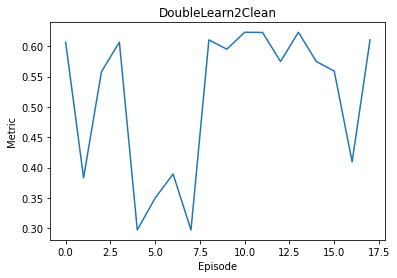

In [26]:
# Learn2clean finds the best strategy WR -> IQR -> NB for maximal accuracy : 0.7052631578947368 for NB
# in  2.96 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'NB', 'Survived', None, 'Tree -> IQR -> NB', 'accuracy', 0.7052631578947368, 2.9261510372161865)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='KMEANS',target_goal='Survived',threshold = 0.6,target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

## Random data preprocessing pipelines

In [29]:
import learn2clean.loading.reader as rd 
import learn2clean.qlearning.qlearner as ql

titanic = ["../datasets/titanic/titanic_train.csv","../datasets/titanic/test.csv"]
hr=rd.Reader(sep=',',verbose=False, encoding=False) 
dataset=hr.train_test_split(titanic, 'Survived')


# random preprocessing pipeline for classification ; 
# the results of random cleaning are stored in 'titanic_example'_results_file.txt in 'save' directory
# appended to the EOF but random cleaning may raise errors and have no result

#random preprocessing pipeline for CART classification
random1=ql.Qlearner(dataset = dataset,goal='CART',target_goal='Survived',target_prepare=None, verbose = False)
random1.random_cleaning('titanic_example')

#random preprocessing pipeline for LDA classification
random2=ql.Qlearner(dataset,goal='LDA',target_goal='Survived',target_prepare=None, verbose = True)
random2.random_cleaning('titanic_example')

#random preprocessing pipeline for NB classification
random3=ql.Qlearner(dataset,goal='NB',target_goal='Survived', threshold=0.6, target_prepare=None, verbose = False)
random3.random_cleaning('titanic_example')

random4=ql.Qlearner(dataset = dataset,goal='LASSO',target_goal='Survived',target_prepare=None, verbose = False)
random4.random_cleaning('titanic_example')

random5=ql.Qlearner(dataset = dataset,goal='OLS',target_goal='Survived',target_prepare=None, verbose = False)
random5.random_cleaning('titanic_example')

random6=ql.Qlearner(dataset = dataset,goal='MARS',target_goal='Survived',target_prepare=None, verbose = False)
random6.random_cleaning('titanic_example')

random7=ql.Qlearner(dataset = dataset,goal='HCA',target_goal='Survived',target_prepare=None, verbose = False)
random7.random_cleaning('titanic_example')

random8=ql.Qlearner(dataset = dataset,goal='KMEANS',target_goal='Survived',target_prepare=None, verbose = False)
random8.random_cleaning('titanic_example')





--------------------------
Random cleaning strategy:
 EM -> ZS -> Tree -> ED -> CART
--------------------------

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.2170271873474121 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02035689353942871 seconds


>>D

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.2611258029937744 seconds

>>Normalization 
* For train dataset
ZS normalizing... 
... train dataset
* For test dataset
ZS normalizing... 
... test dataset
Normalization done -- CPU time: 0.01578807830810547 seconds


>>Outlier detection and removal:
* For train dataset
164 outlying rows have been removed:
with indexes: [6, 7, 10, 11, 15, 16, 24, 32, 33, 43, 50, 52, 54, 58, 63, 64, 78, 94, 95, 96, 110, 116, 119, 124, 132, 147, 150, 152, 155, 164, 165, 170, 171, 172, 174, 177, 182, 183, 184, 193, 195, 205, 222, 232, 233, 237, 249, 252, 259, 261, 262, 268, 275, 278, 280, 297, 299, 305, 317, 326, 340, 348, 366, 374, 381, 386, 406, 407, 434, 438, 445, 448, 449, 453, 456, 458, 460, 462, 463, 467, 469, 479, 480, 482, 483, 487, 489, 492, 493, 496, 513, 515, 526, 530, 535, 541, 544, 545, 549, 555, 556, 570, 571, 582, 586, 587, 591, 592, 597, 599, 618, 625, 

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.20480585098266602 seconds


>>Outlier detection and removal:
* For train dataset
212 outlying rows have been removed
* For test dataset
311 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.013965845108032227 seconds


>>Classification task
Accuracy of Naive Naive Bayes classification for 10 cross-validation : 0.6834503950834064

Classification done -- CPU time: 0.039727210998535156 seconds
End Pipeline CPU time: 0.26656174659729004 seconds
('titanic_example', 'random', 'NB', 'Survived', None, 'EM -> IQR -> NB', 'accuracy', ({'quality_metric': 0.6834503950834064}, 0.26656174659729004))


--------------------------
Random cleaning strategy:
 KNN -> LC -> LASSO
--------------------------

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Emba

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.2879741191864014 seconds


>>Feature selection 
Before feature selection:
11 features 
Apply LC feature selection with threshold= 0.3
5 features with linear correlation greater than 0.30.

List of correlated variables to be removed : ['Fare', 'Parch', 'PassengerId', 'Pclass', 'SibSp']
After feature selection:
6 features remain
['Embarked', 'Ticket', 'Age', 'Sex', 'Cabin', 'Name']
Feature selection done -- CPU time: 0.014458894729614258 seconds


>>Regression task
Error: Need at least one continous variable and  10  observations for regression
Regression done -- CPU time: 0.0037980079650878906 seconds
End Pipeline CPU time: 1.3146271705627441 seconds
('titanic_example', 'random', 'LASSO', 'Survived', None, 'KNN -> LC -> LASSO', 'MSE', ({'quality_metric': None}, 1.3146271705627441))


--------------------------
Random cleaning strategy:
 KNN -> MF ->

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any valu

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.2695229053497314 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 689 missing values in ['Cabin', 'Embarked']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1016 missing values in ['Cabin', 'Embarked']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
Imputation done -- CPU time: 0.04351305961608887 seconds


>>Feature selection 
Before feature selection:
11 features 
Apply MR feature selection with missing threshold= 0.3
0 features with greater than 0.30 missing values.

List of variables to be removed : []
After feature selection:
11 features remain
['SibSp',

const          0.450915
SibSp         -0.000377
Fare          -0.000377
Parch         -0.000377
Age           -0.000377
Pclass        -0.000377
PassengerId   -0.000377
dtype: float64

,const,SibSp,Fare,PassengerId,Parch,Age,Pclass
0,1.0,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000
1,1.0,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000
2,1.0,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000
3,1.0,35.000000,35.000000,35.000000,35.000000,35.000000,35.000000
4,1.0,35.000000,35.000000,35.000000,35.000000,35.000000,35.000000
...,...,...,...,...,...,...,...
1304,1.0,29.423195,29.423195,29.423195,29.423195,29.423195,29.423195
1305,1.0,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000
1306,1.0,38.500000,38.500000,38.500000,38.500000,38.500000,38.500000
1307,1.0,36.739320,36.739320,36.739320,36.739320,36.739320,36.739320


(7,)

(1309, 7)

(7,)

(1309, 7)

MODIFICATION
Regression done -- CPU time: 0.026262998580932617 seconds
End Pipeline CPU time: 1.367492914199829 seconds
('titanic_example', 'random', 'OLS', 'Survived', None, 'KNN -> MF -> MR -> ED -> OLS', 'MSE', ({'quality_metric': 0.23677221654749742}, 1.3674919605255127))


--------------------------
Random cleaning strategy:
 WR -> LOF -> MARS
--------------------------

Start pipeline
-------------

>>Feature selection 
Before feature selection:
11 features 
Apply WR feature selection
Input variables must be non-negative. WR feature selection is only applied to positive variables.
After feature selection:
6 features remain
['SibSp', 'Fare', 'Parch', 'Age', 'Pclass', 'PassengerId']
Feature selection done -- CPU time: 0.012888193130493164 seconds


>>Outlier detection and removal:
* For train dataset
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detecti

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-

MSE of MARS with 10 folds for cross-validation: 0.31803720147714504
Regression done -- CPU time: 0.8325231075286865 seconds
End Pipeline CPU time: 0.8722860813140869 seconds
('titanic_example', 'random', 'MARS', 'Survived', None, 'WR -> LOF -> MARS', 'MSE', ({'quality_metric': 0.31803720147714504}, 0.8722860813140869))


--------------------------
Random cleaning strategy:
 EM -> MR -> IQR -> HCA
--------------------------

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imp

/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25

{'quality_metric': 0.4268,
 'result': {'train':           Age      Fare     Parch  PassengerId    Pclass     SibSp  cluster_ID
  0    0.333333  0.104173  0.000000     0.000000  1.000000  0.833333           2
  2    0.466468  0.226454  0.000000     0.002247  1.000000  0.000000           1
  4    0.710629  0.244569  0.000000     0.004494  1.000000  0.000000           1
  5    0.467221  0.303740  0.000000     0.005618  1.000000  0.000000           1
  6    0.912458  0.826262  0.000000     0.006742  0.000000  0.000000           0
  ..        ...       ...       ...          ...       ...       ...         ...
  885  0.789518  0.704776  0.977778     0.994382  1.000000  0.000000           1
  886  0.496164  0.444444  0.000000     0.995506  0.388889  0.000000           0
  887  0.222222  0.715447  0.000000     0.996629  0.000000  0.000000           0
  889  0.466468  0.715447  0.000000     0.998876  0.000000  0.000000           0
  890  0.638889  0.122809  0.000000     1.000000  1.000000  0.0

In [28]:
# no preprocessing: results appended to the EOF 'titanic_example'_results.txt 


no_prep1=ql.Qlearner(dataset = dataset,goal='CART',target_goal='Survived',target_prepare=None, verbose = False)
no_prep1.no_prep('titanic_example')

no_prep2=ql.Qlearner(dataset = dataset,goal='LDA',target_goal='Survived',target_prepare=None, verbose = False)
no_prep2.no_prep('titanic_example')

no_prep3=ql.Qlearner(dataset = dataset,goal='NB',target_goal='Survived',target_prepare=None, verbose = False)
no_prep3.no_prep('titanic_example')


Start pipeline
-------------

>>Classification task
Avg accuracy of CART classification for 10 cross-validation : 0.7017410015649452

Classification done -- CPU time: 20.385674953460693 seconds
End Pipeline CPU time: 20.3906409740448 seconds

Start pipeline
-------------

>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.7058823529411764

Classification done -- CPU time: 0.02582406997680664 seconds
End Pipeline CPU time: 0.028964996337890625 seconds

Start pipeline
-------------

>>Classification task
Accuracy of Naive Naive Bayes classification for 10 cross-validation : 0.6682511737089201

Classification done -- CPU time: 0.04208993911743164 seconds
End Pipeline CPU time: 0.04526400566101074 seconds


/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2c/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m